# Number 1:

Plot your standard star instrumental magnitudes from HW6 versus their airmass (or since you have many different standard stars taken at different airmass, plot the difference between the accepted magnitude and your instrumental magnitude versus airmass). Use one of the linear fitting routines in Python to do a least squares fit to find and plot the extinction coefficients at each filter. You can find the standard star magnitudes and colors in Landolt (1992).

In [1]:
# import block
import numpy as np
from astropy.io import fits
%matplotlib inline
from matplotlib import pyplot as plt
from astropy.visualization import hist
import ccdproc as ccdp
from matplotlib import rc
from datetime import datetime
from ccdproc import ImageFileCollection
import ccdproc as ccdp
from astropy.modeling.models import Polynomial1D,Chebyshev1D,Legendre1D,Hermite1D, Gaussian1D
from astropy.modeling import fitting
from astropy.stats import mad_std
from astropy.nddata import CCDData
from scipy import stats
from astropy import units as u
from photutils.aperture import CircularAperture,CircularAnnulus
from photutils.aperture import aperture_photometry
from astropy.stats import sigma_clipped_stats
from photutils.detection import DAOStarFinder
from astropy.table import Table
#import sfdmap
#import extinction
from astropy.coordinates import SkyCoord
from scipy.stats import linregress

In [2]:
# import convenience plotting functions downloaded from 
# here: https://github.com/mwcraig/ccd-reduction-and-photometry-guide
#phot_tutorial_dir = '/Users/runnojc1/Dropbox/Research/teaching/F2021/ASTR8060/work/reductions/example/notebooks'
phot_tutorial_dir ="/Users/jonathanrodriguez/Documents/ASTR8060/repos/phot_tutorial/ccd-reduction-and-photometry-guide/notebooks/"

import sys
sys.path.insert(0,phot_tutorial_dir)
from convenience_functions import show_image

In [3]:
# plotting defaults
# Use custom style for larger fonts and figures
plt.style.use(phot_tutorial_dir+'/guide.mplstyle')

# Set some default parameters for the plots below
rc('font', size=20)
rc('axes', grid=True) 

In [4]:
data_dir = '/Users/jonathanrodriguez/Documents/ASTR8060/Imaging/'
reduced_dir = '/Users/jonathanrodriguez/Documents/ASTR8060/Reductions1/'

I will be using the Landolt table below in order to pull the B-V values for later use. 

In [8]:
# create an astropy table with the standard star info
landolt = Table()
landolt['V']   = [14.397,15.256,12.969,13.229,13.691]
landolt['B-V'] = [-0.192,0.837,1.081,1.134,0.535] 
landolt['U-B'] = [-0.874,0.320,1.007,1.138,-0.025]
landolt['V-R'] = [-0.093,0.505,0.590,0.618,0.324]
landolt['R-I'] = [-0.116,0.511,0.502,0.523,0.327]
landolt['V-I'] = [-0.212,1.015,1.090,1.138,0.650]

landolt['B'] = landolt['B-V']+landolt['V']
landolt['U'] = landolt['U-B']+landolt['B']
landolt['R'] = landolt['V']-landolt['V-R']
landolt['I'] = landolt['V']-landolt['V-I']

In [9]:
landolt

V,B-V,U-B,V-R,R-I,V-I,B,U,R,I
float64,float64,float64,float64,float64,float64,float64,float64,float64,float64
14.397,-0.192,-0.874,-0.093,-0.116,-0.212,14.205,13.331,14.49,14.609
15.256,0.837,0.32,0.505,0.511,1.015,16.093,16.413,14.751,14.241
12.969,1.081,1.007,0.59,0.502,1.09,14.049999999999999,15.056999999999999,12.379,11.879
13.229,1.134,1.138,0.618,0.523,1.138,14.363,15.501,12.610999999999999,12.091
13.691,0.535,-0.025,0.324,0.327,0.65,14.226,14.201,13.367,13.041


The function below comes from the Homework 6 solutions given to us by Dr. Runnoe at Vanderbilt University. Its purpose is to calculate the instrumental magnitudes of any given science frame. For our purposes in this question, it will be used to find the instrumental magnitudes of the standard stars located in PG 1633. It has also been modified to calculate the difference between the instrumental magnitudes and the real magnitudes as is recorded in the Landolt (1992) paper. 

In [10]:
def get_phot(file,approx_pos,title):
    '''
    This function takes an input file, list of positions for stars to find, and plot title.
    
    It executes the following steps:
    1. Read in the data.
    2. Find all sources in the image. It assumes the FWHM is approximately 4 pix and finds everything greater than 10 sigma.
    3. It collects the info for the sources given in the input position list, matching within 10 pixel positions.
    4. It puts r=10pix apertures on each of these stars, as well as r_in=15, r_out=20 background annuli.
    5. It calculates background-subtracted instrumental magnitudes.
    6. It plots the image and apertures for visual inspection.
    7. It returns a table of photometry.
    '''
    fwhm       = 4.0
    source_snr = 10

    sci        = CCDData.read(file,unit='adu')
    data       = sci.data
    hdr        = sci.header
    
    mean, median, std = sigma_clipped_stats(data, sigma=3.0)    
    daofind = DAOStarFinder(fwhm=fwhm, threshold=source_snr*std)    
    sources = daofind(data)
    
    positions = np.zeros_like(approx_pos)
    for position,i in zip(approx_pos,range(np.shape(approx_pos)[0])):
        match = np.where((abs(sources['xcentroid']-position[0])<10) & (abs(sources['ycentroid']-position[1])<10))[0][0]
        positions[i] = (sources['xcentroid'][match],sources['ycentroid'][match])
          
    # photometry
    # biggest FWHM is 4.2 pix
    aperture  = CircularAperture(positions, r=4)
    phot = aperture_photometry(data, aperture)
    for col in phot.colnames:
        phot[col].info.format = '%.8g'              # for consistent table output
        
    # calculate the mean background
    # note that for PG1633+099, this will include two little stars :(
    annulus_aperture = CircularAnnulus(positions, r_in=15., r_out=20.)
    bg   = aperture_photometry(data,annulus_aperture)
    for col in bg.colnames:
        bg[col].info.format = '%.8g'                # for consistent table output
    msky = bg['aperture_sum']/annulus_aperture.area # get bg cts/pixel
    
    accepted_magnitudes = [6, 6, 6, 6, 5] #these accepted magnitude values come from the Landolt paper 
    phot['inst_mag'] = -2.5 * np.log10(phot.columns['aperture_sum']-msky*aperture.area)
    
    #Subtract the accepted vs instrumental magnitudes here
    difference = (accepted_magnitudes-phot.columns['inst_mag'])
    for col in phot.colnames:
        phot[col].info.format = '%.8g'
    phot['diff_mag'] = difference

    # show the image with apertures
    fig, ax = plt.subplots(1, 1, figsize=(8, 8))
    show_image(data, cmap='gray', ax=ax, fig=fig)
    aperture.plot(color='green', lw=1.5, alpha=0.5) # apertures
    annulus_aperture.plot(color='red', lw=1.5, alpha=0.5)                        # bg annulus
    ax.set_xlim([800,1500])
    ax.set_ylim([800,1500])
    plt.title(title)
    plt.tight_layout()
    plt.show()
    
    return phot

The cell below also originates from Dr. Runnoe's Homework 6 solutions. Here, we are reading in the specific PG 1633 images that we want, whilst excluding the ones that were taken in the hydrogen alpha filter and that were taken for the linearity test in the V filter. 

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


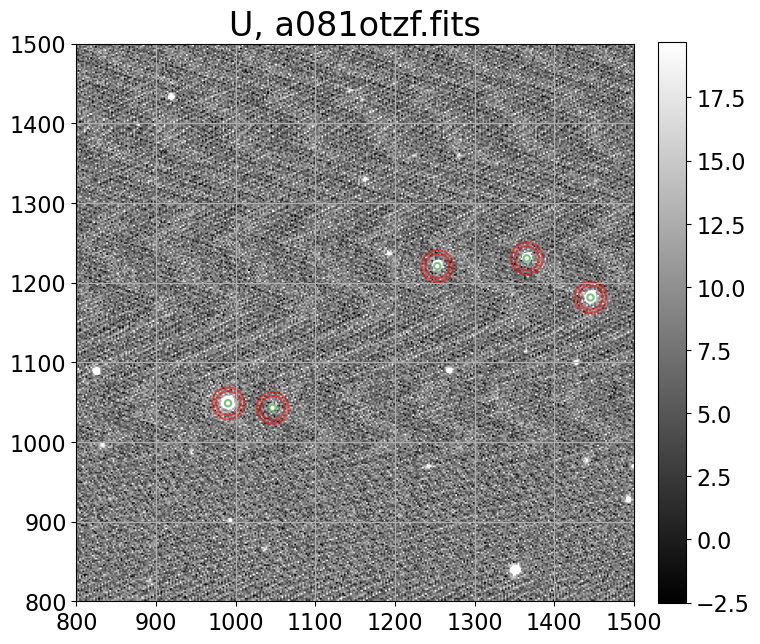

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


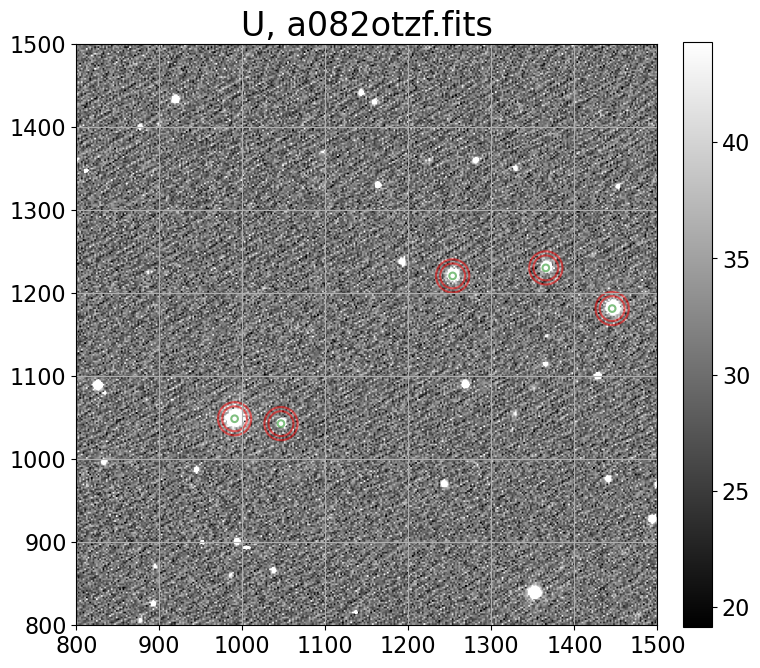

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


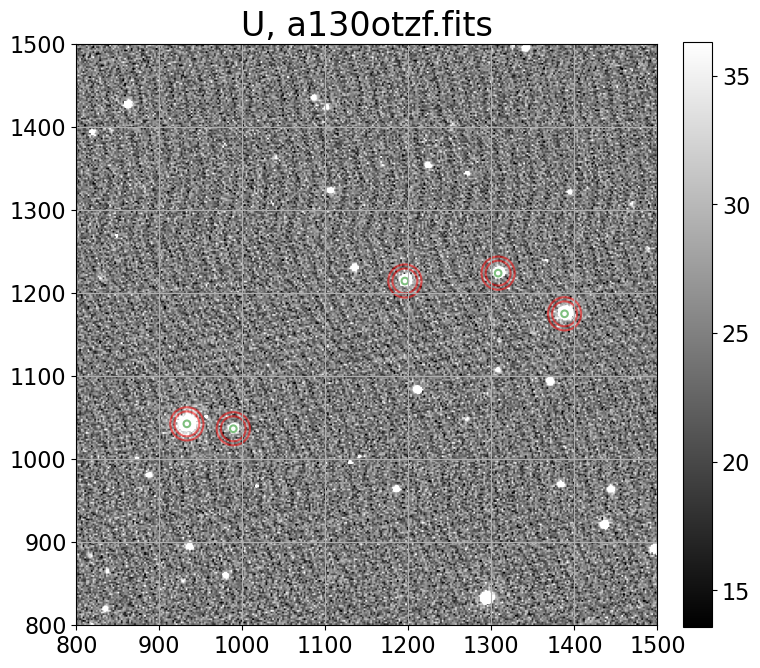

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


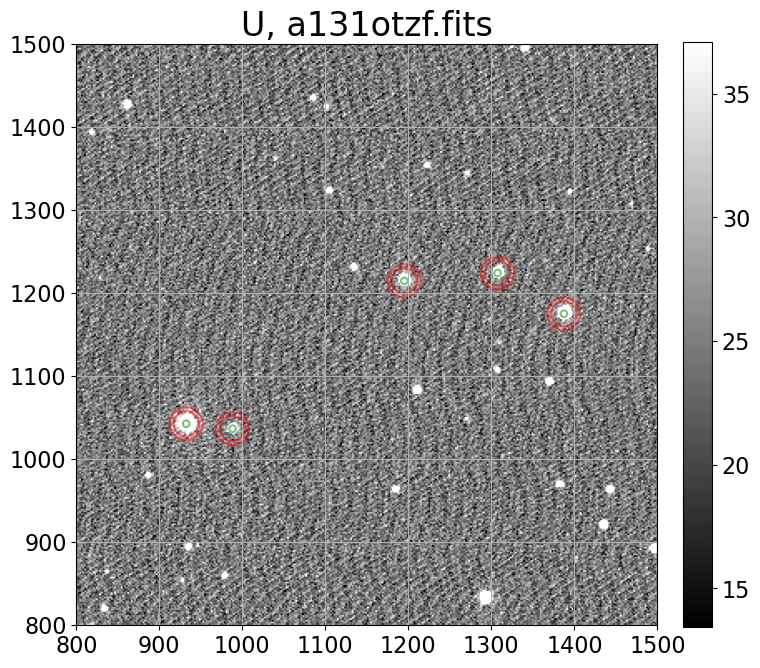

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


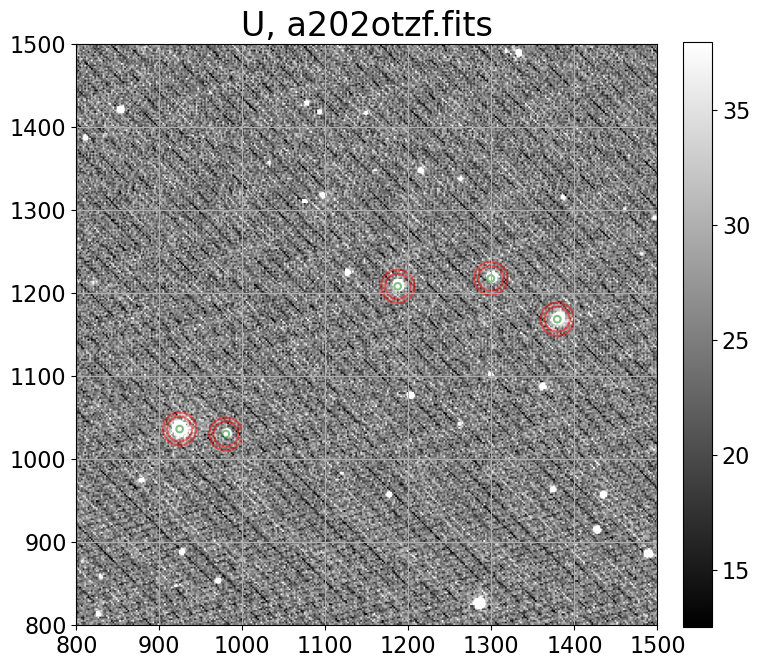

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


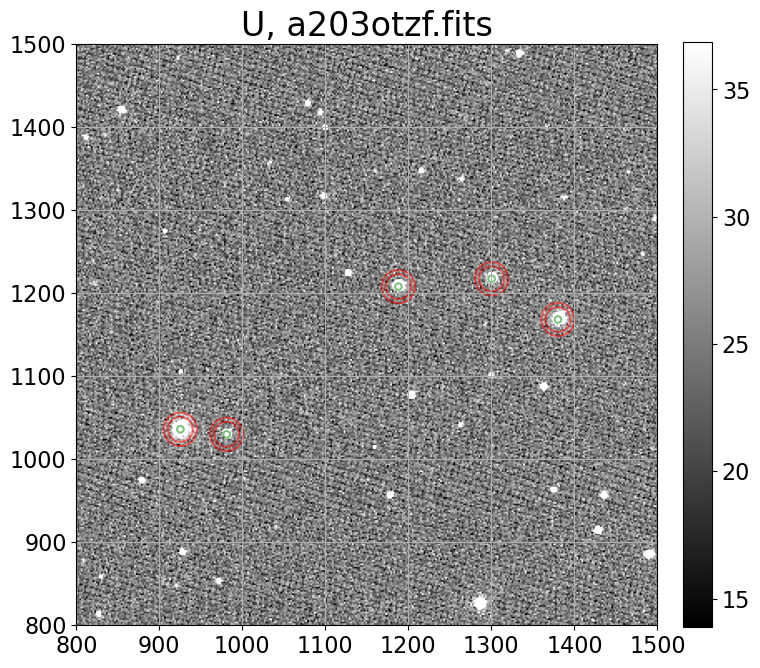

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


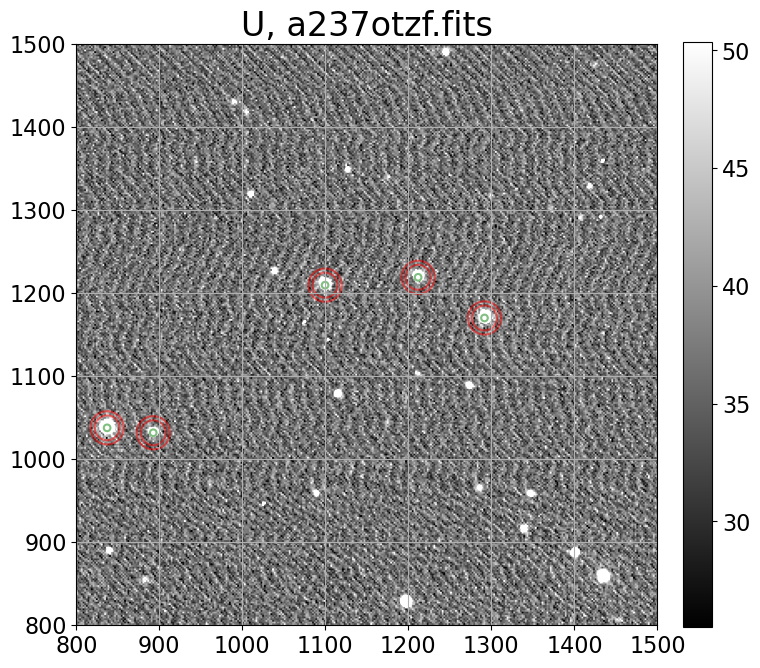

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


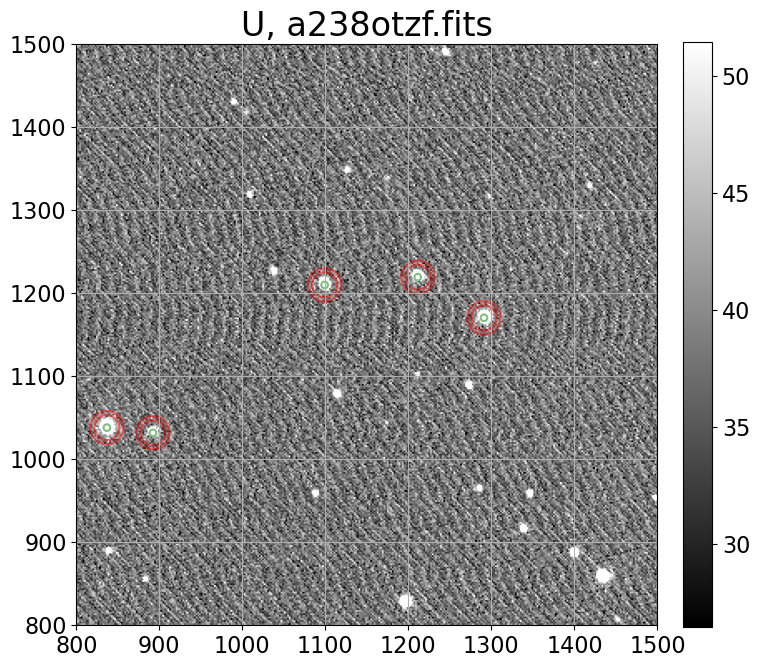

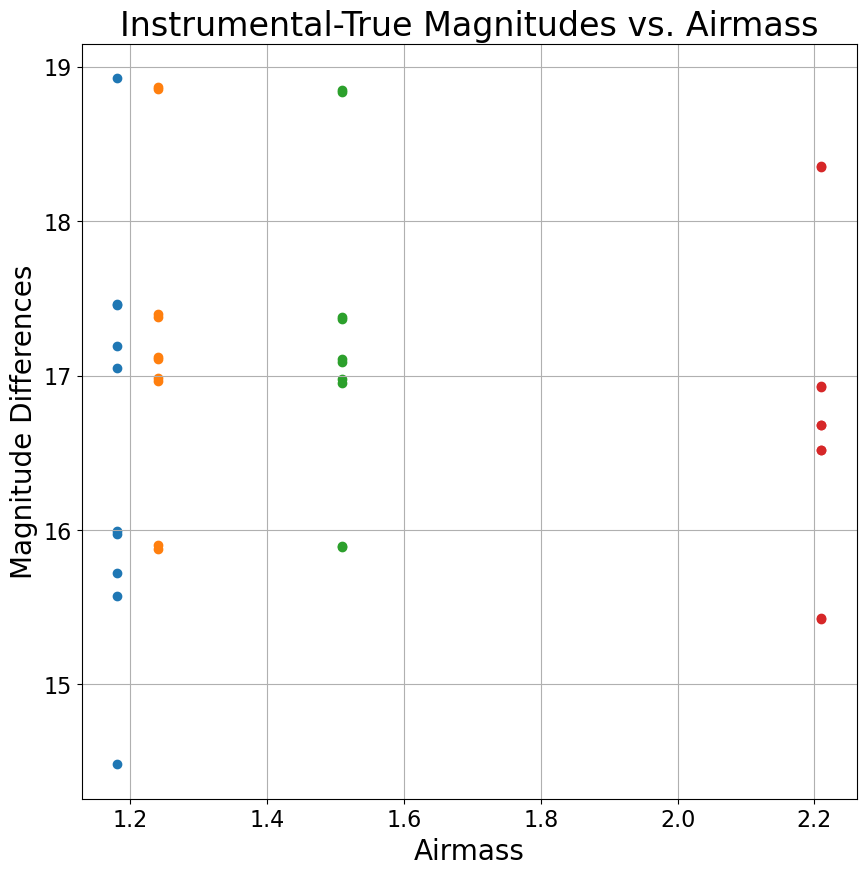

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


LinregressResult(slope=-0.1167294030436613, intercept=17.14063538352047, rvalue=-0.04511018773740768, pvalue=0.7822442088978194, stderr=0.41934503199303114, intercept_stderr=0.6661583244008354)
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


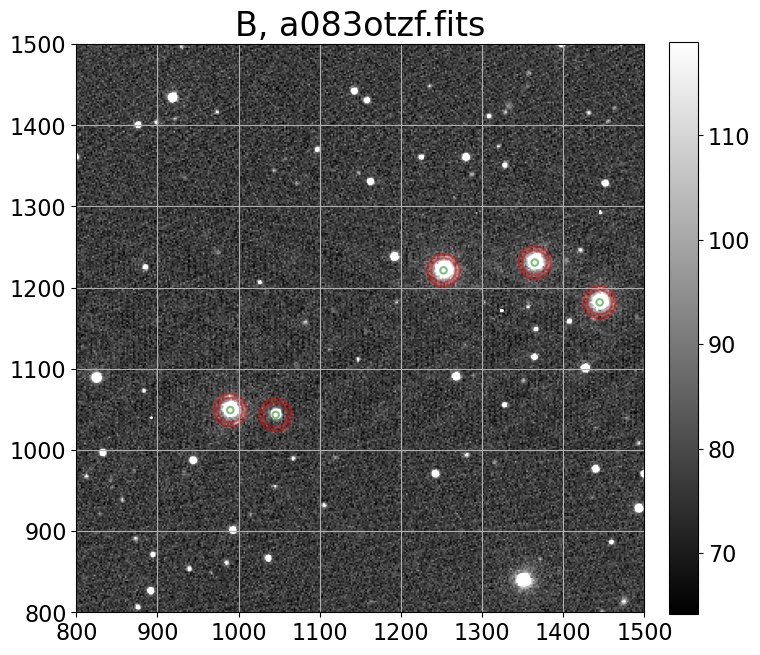

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


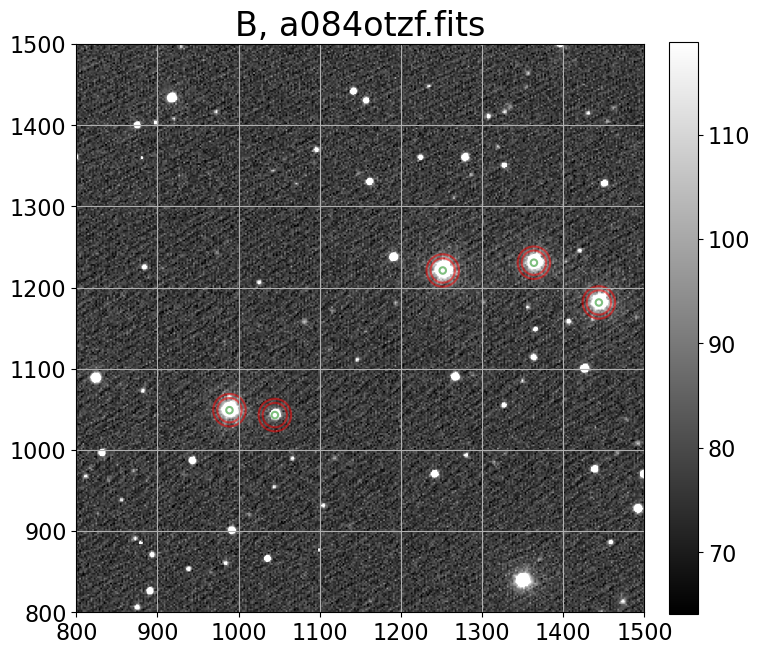

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


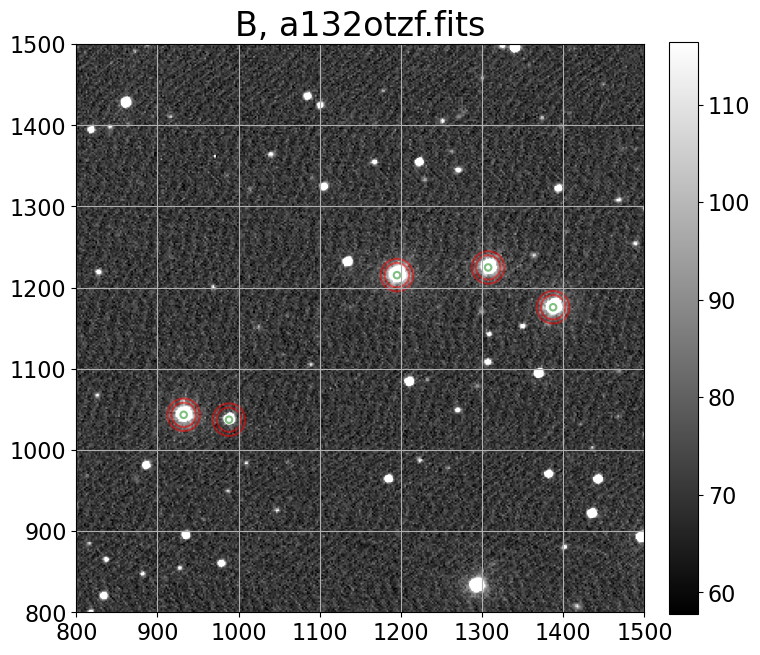

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


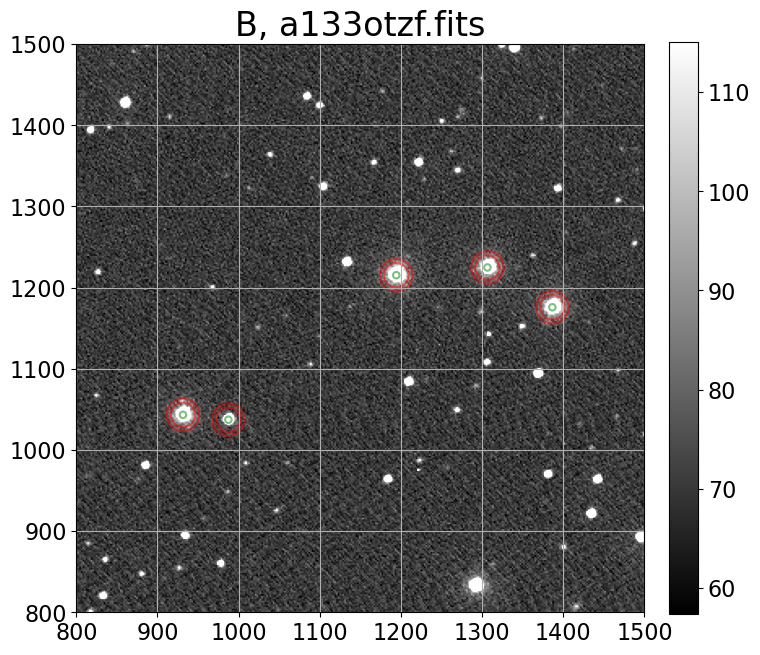

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


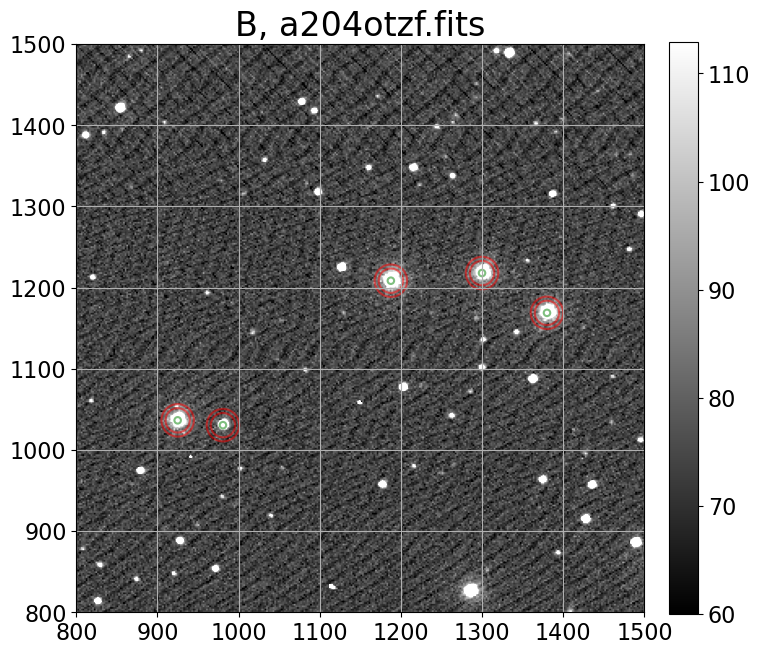

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


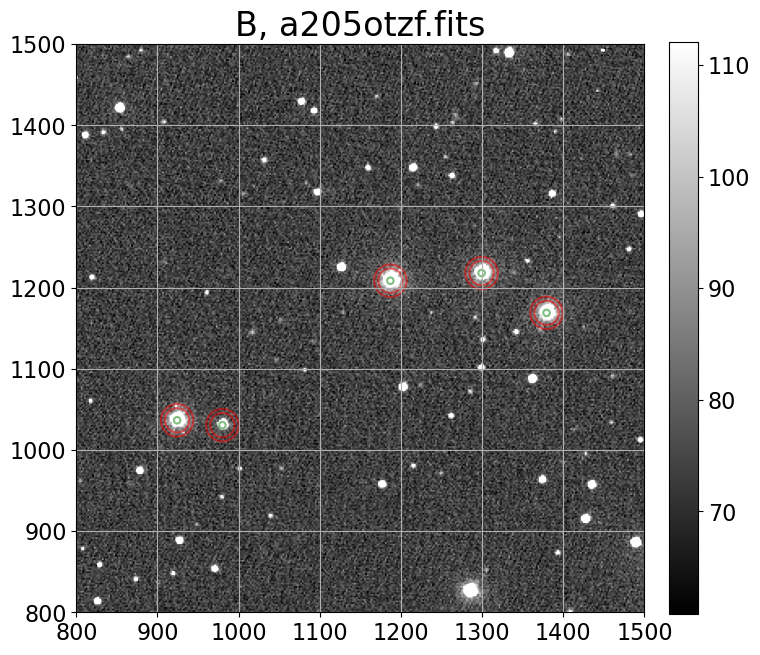

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


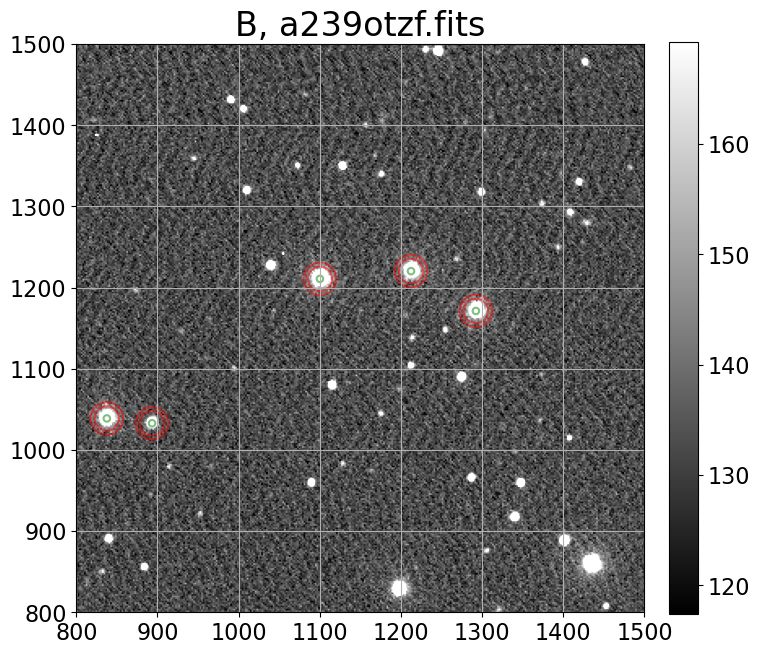

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


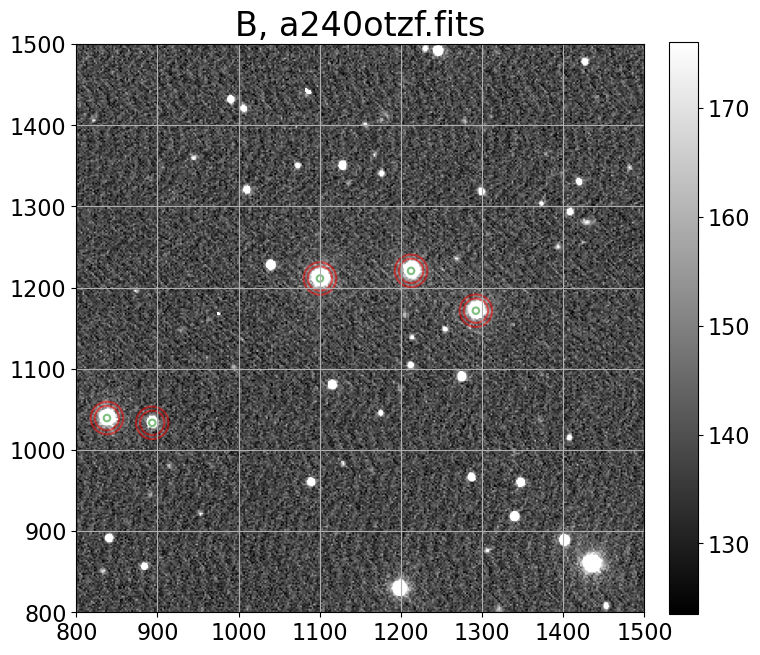

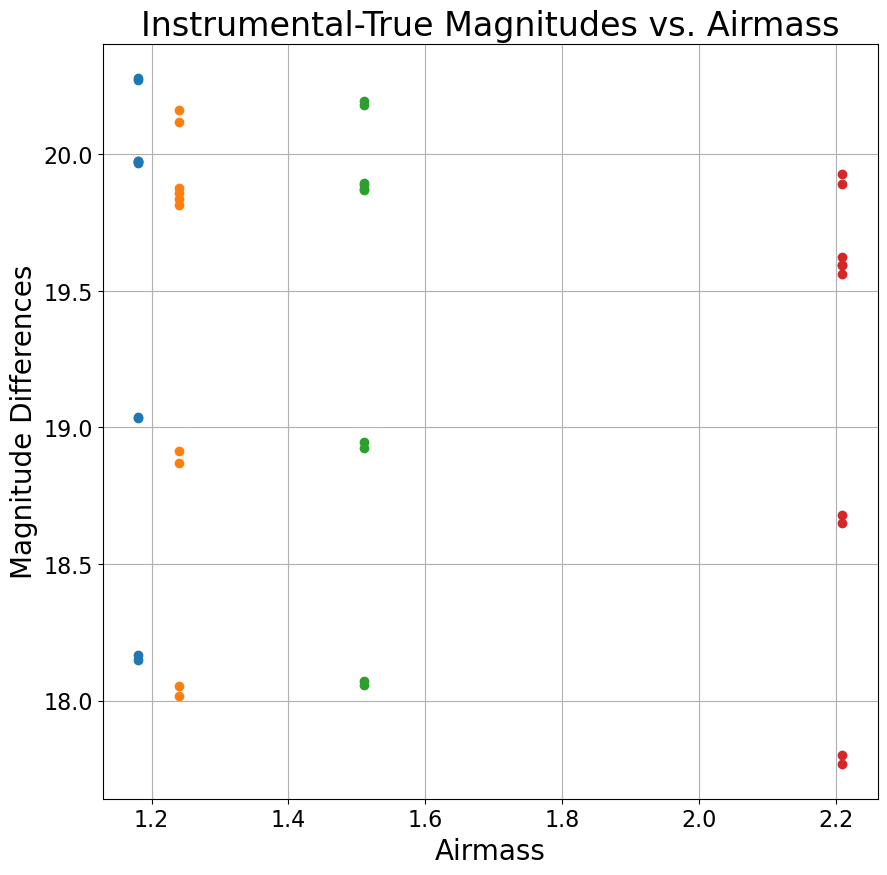

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


LinregressResult(slope=-0.31599148215627776, intercept=19.818944165001998, rvalue=-0.16251154270118165, pvalue=0.31639110036507906, stderr=0.3112342738907869, intercept_stderr=0.4944169754576771)
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


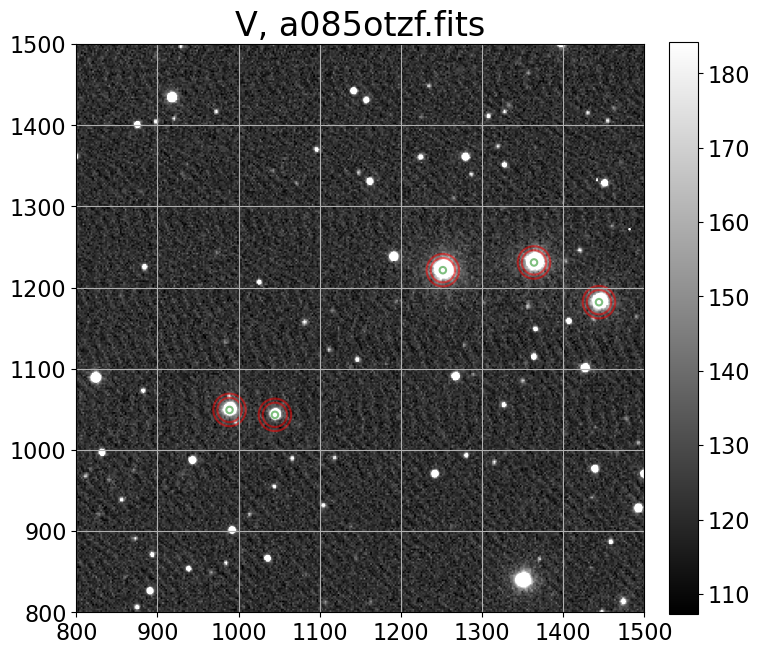

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


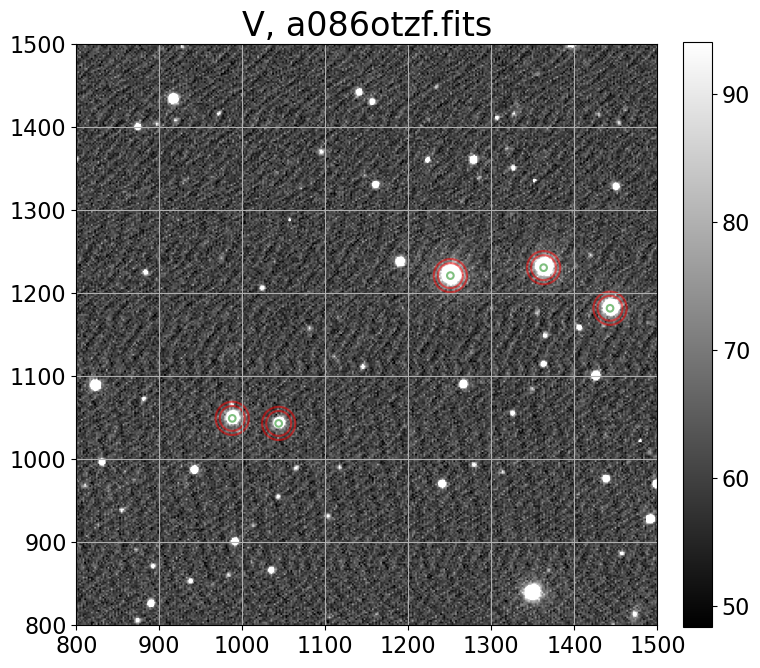

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


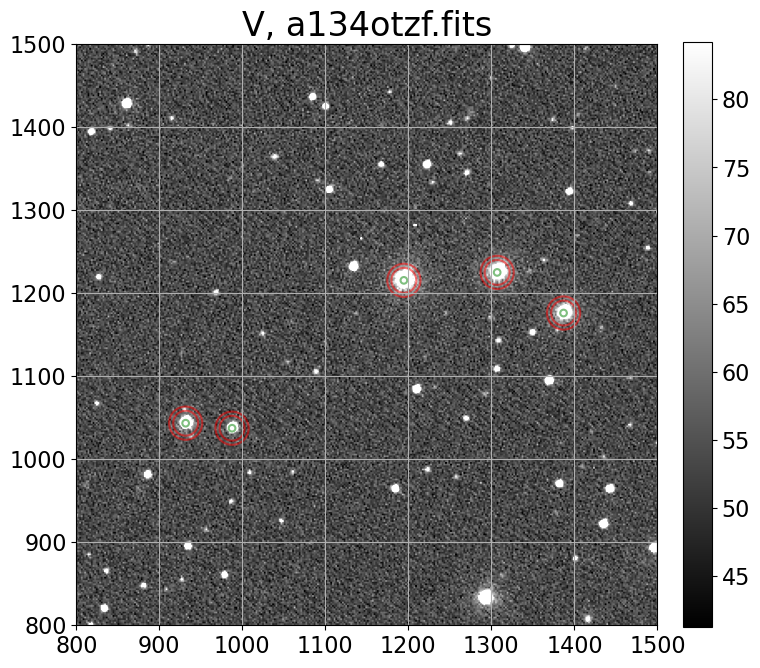

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


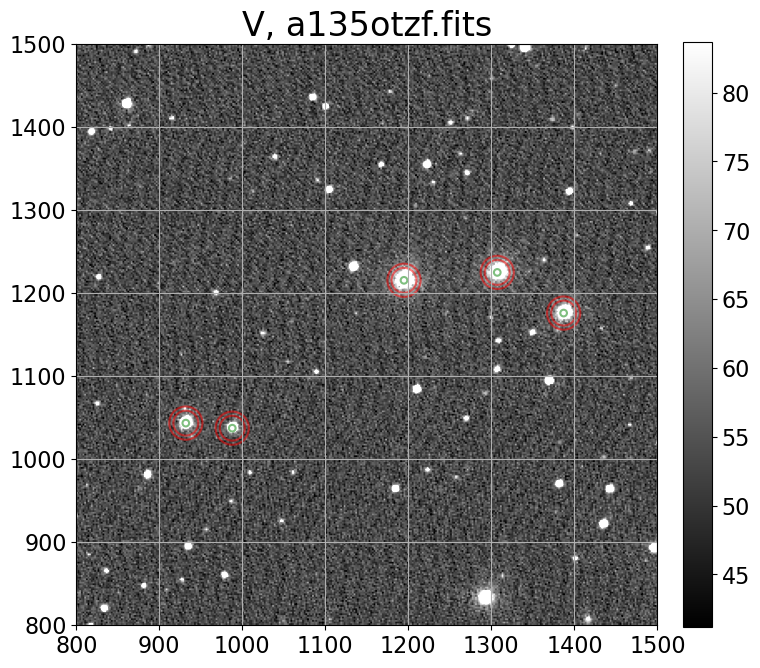

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


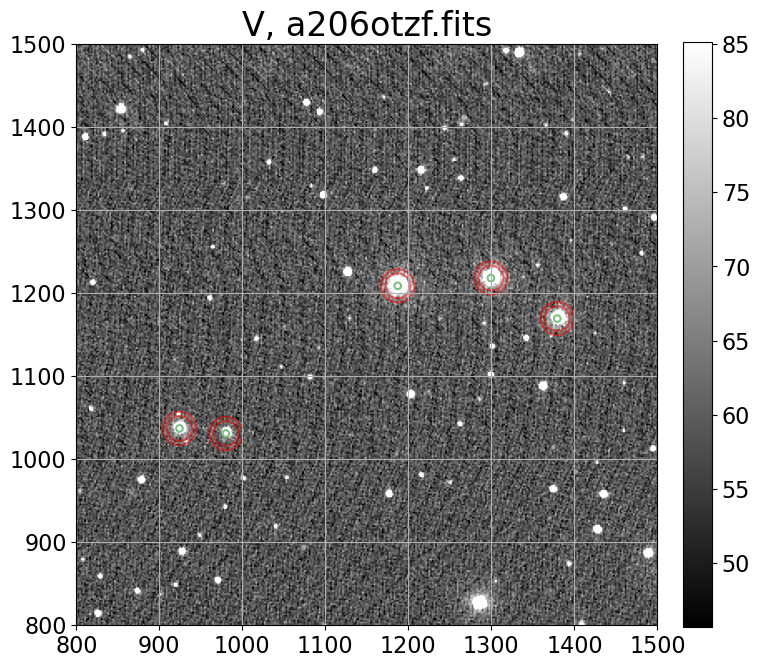

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


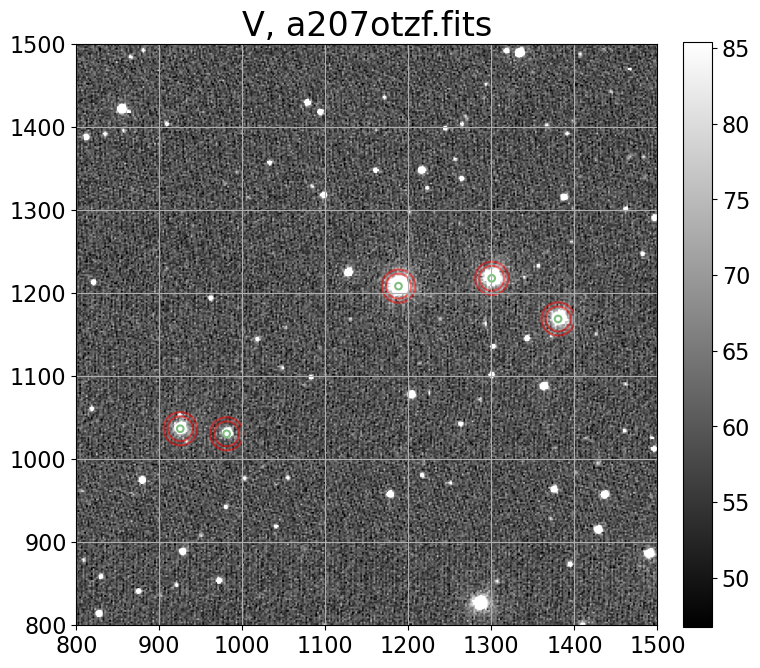

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


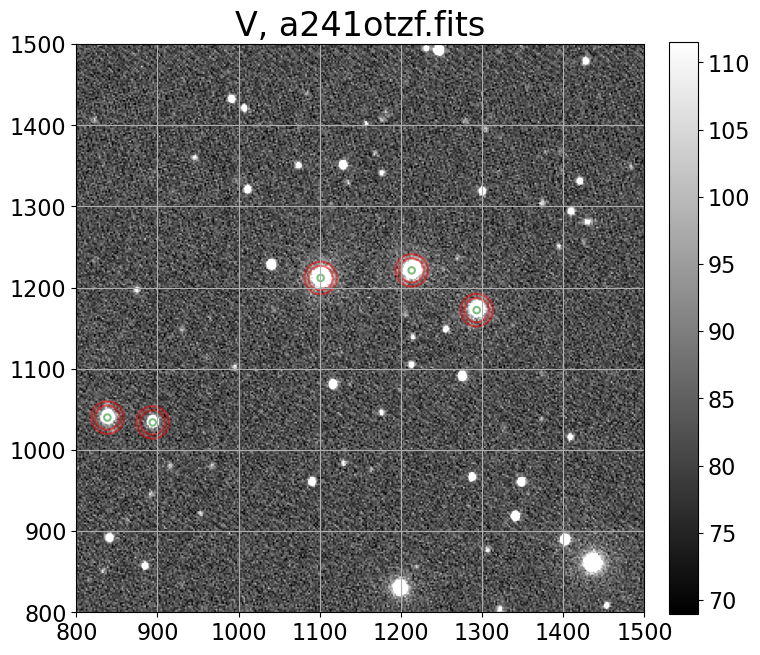

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


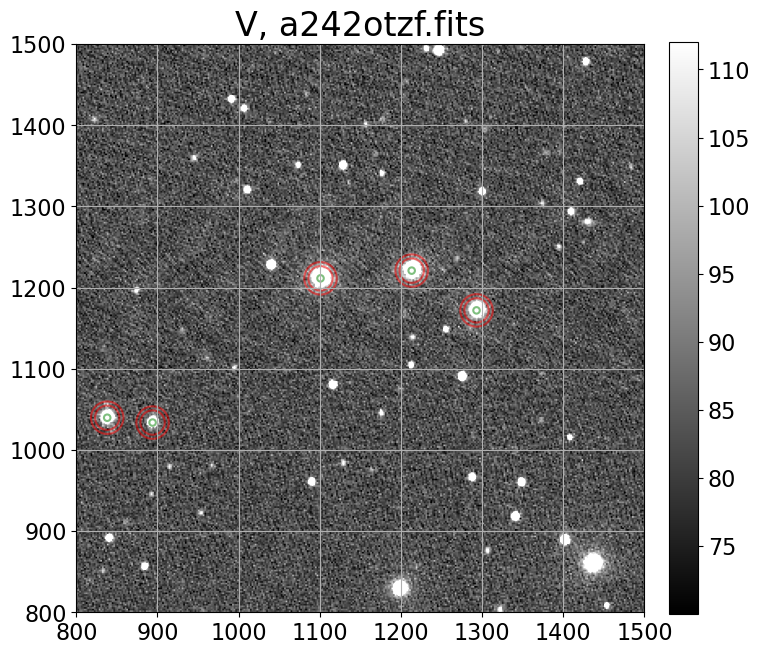

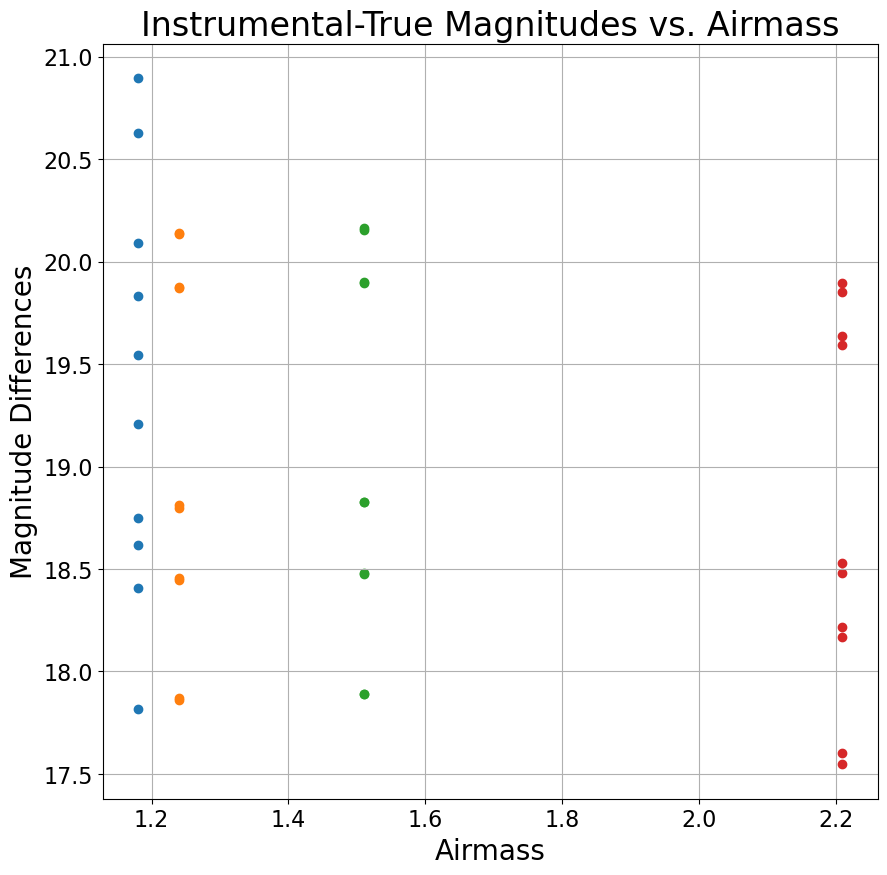

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


LinregressResult(slope=-0.46476510328163206, intercept=19.765299960310564, rvalue=-0.20866541856366355, pvalue=0.1963065213361974, stderr=0.35336566876903047, intercept_stderr=0.5613455838243242)
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


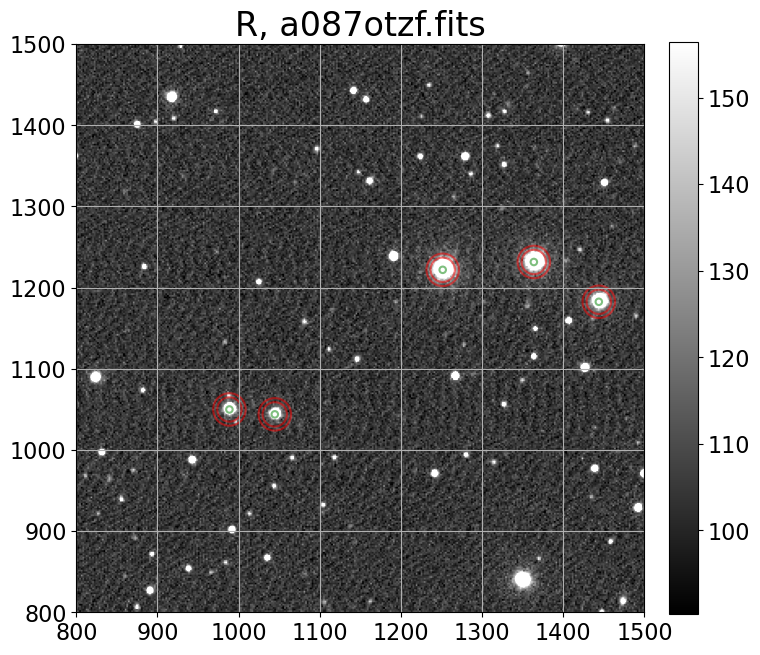

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


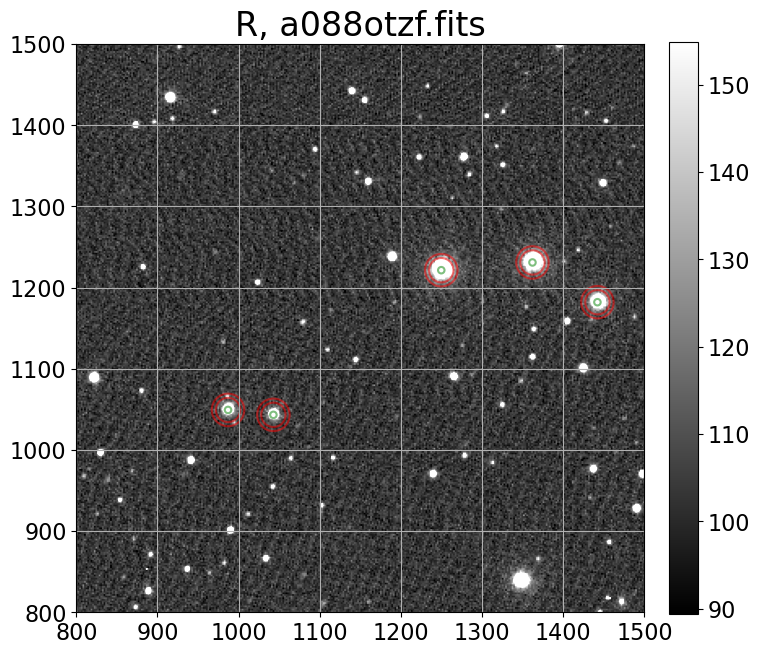

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


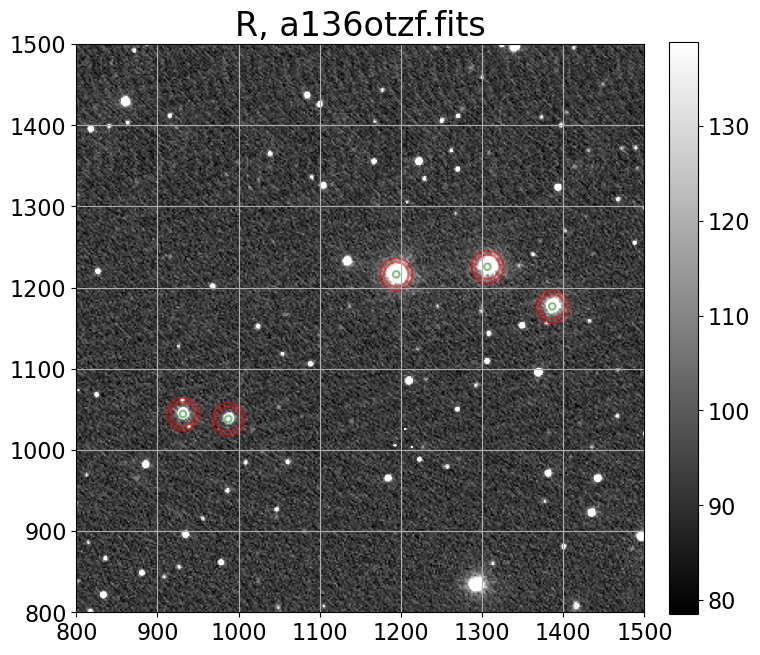

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


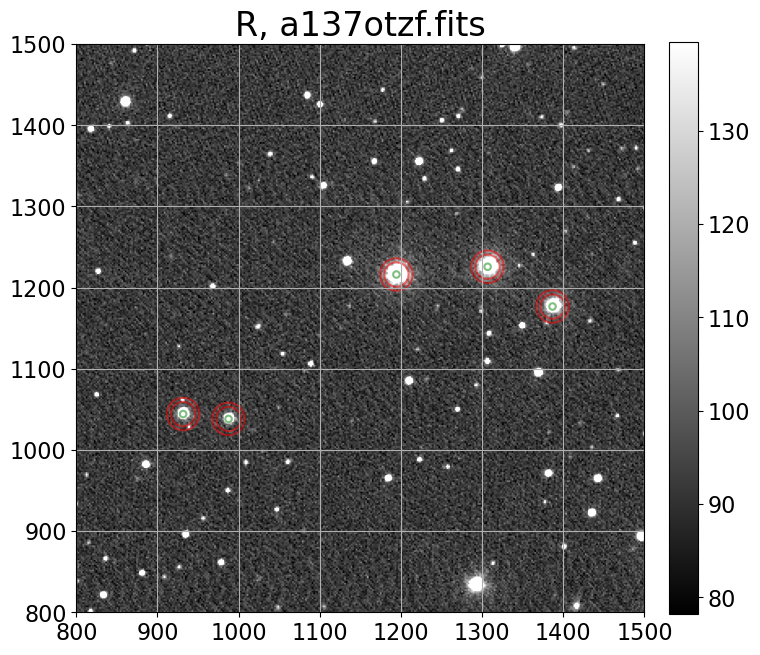

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


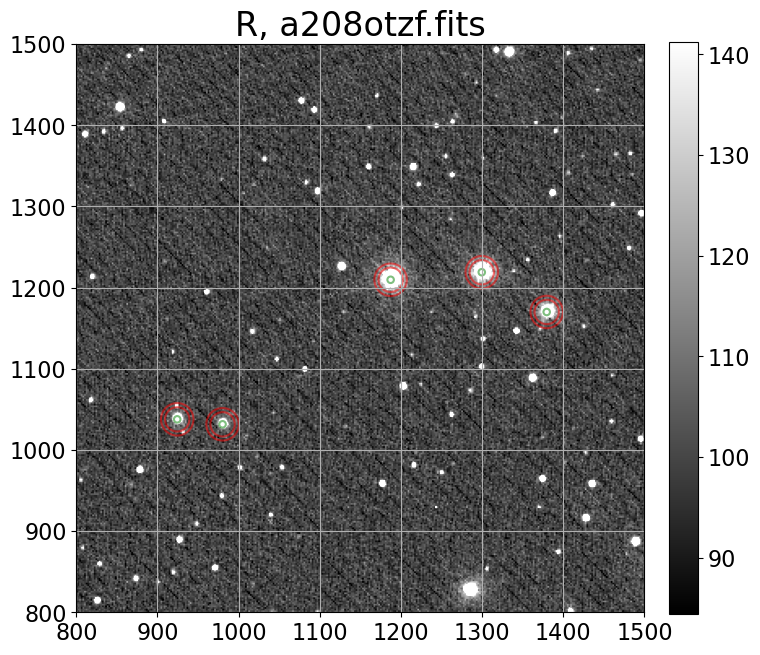

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


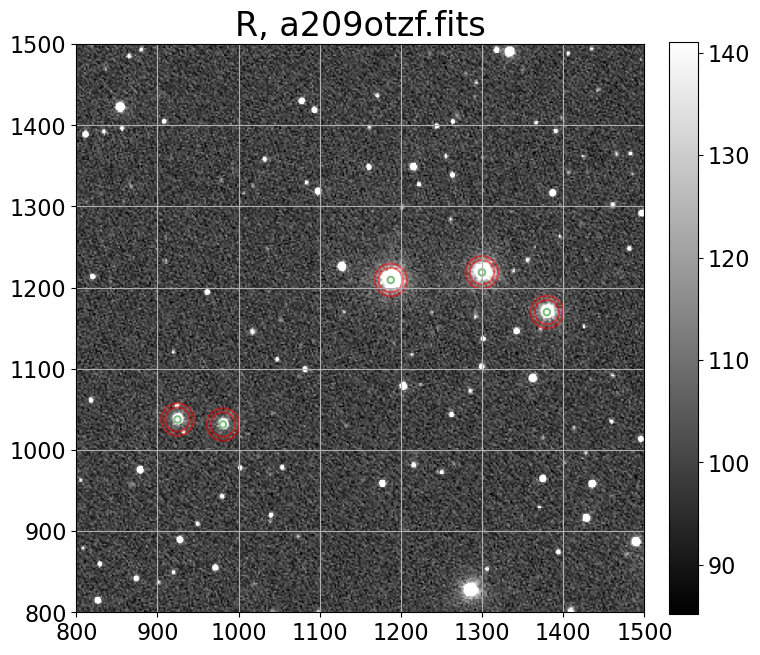

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


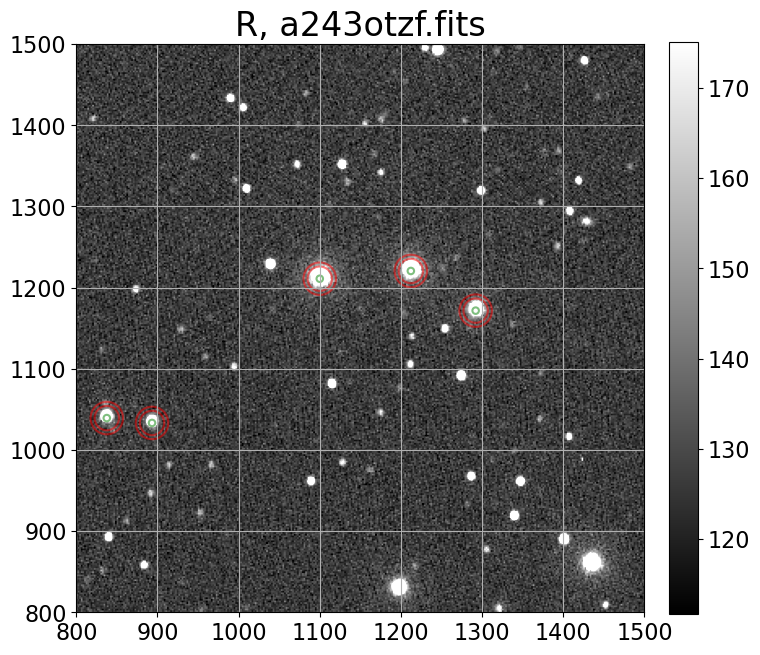

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


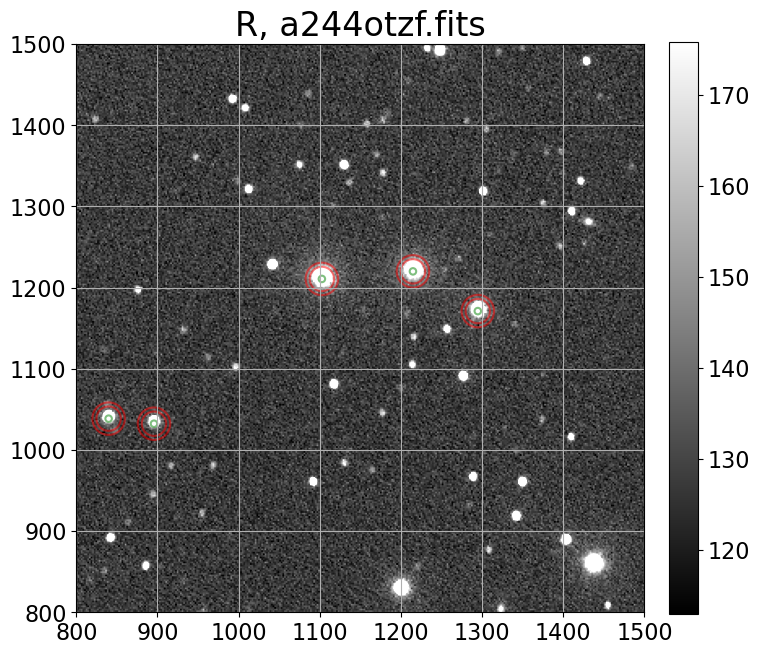

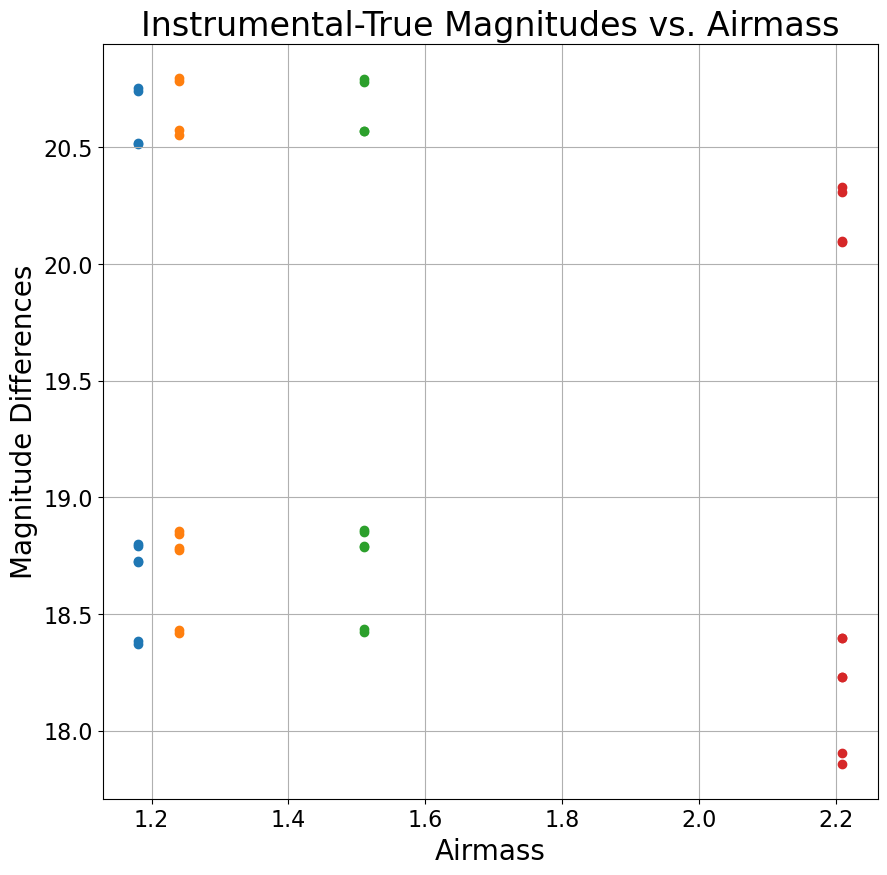

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


LinregressResult(slope=-0.47603720189656995, intercept=20.076718145951737, rvalue=-0.19137929340262158, pvalue=0.23681691569395807, stderr=0.39605144453006347, intercept_stderr=0.6291548642194525)
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


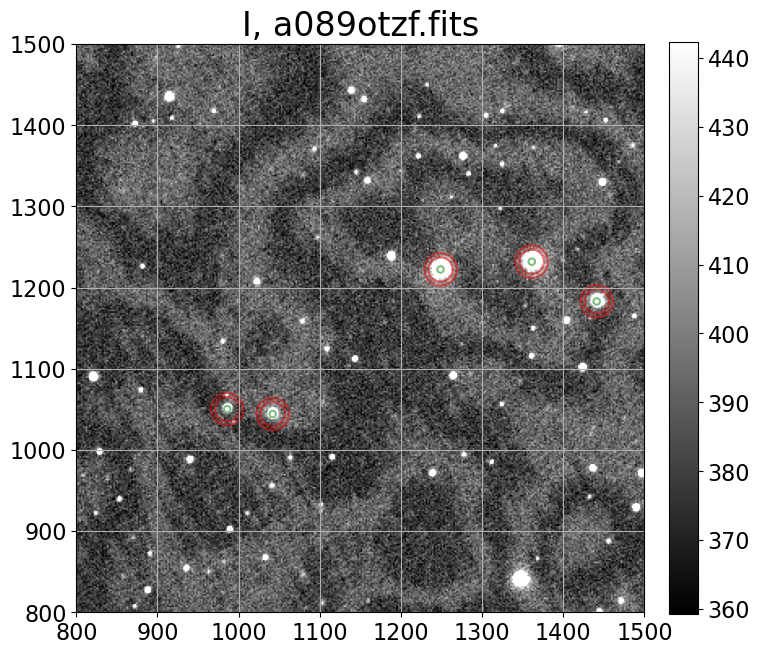

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


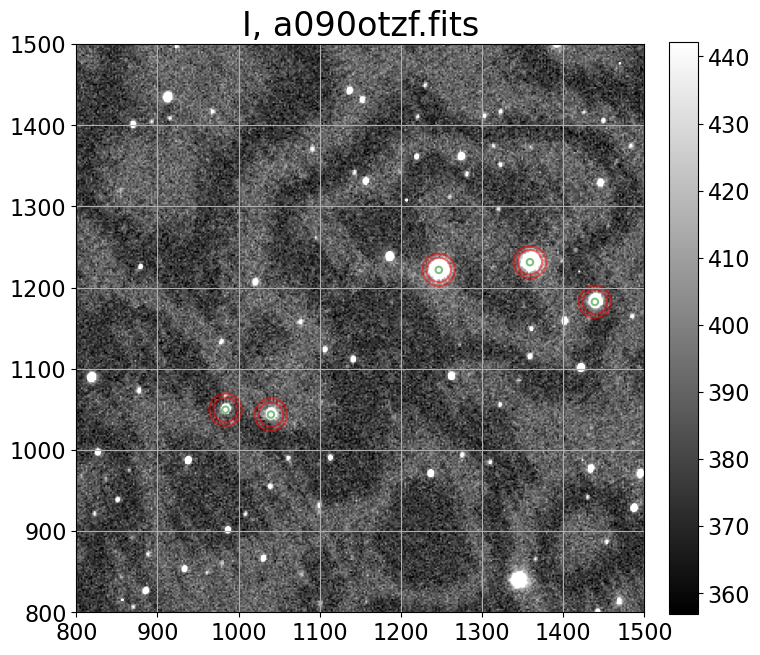

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


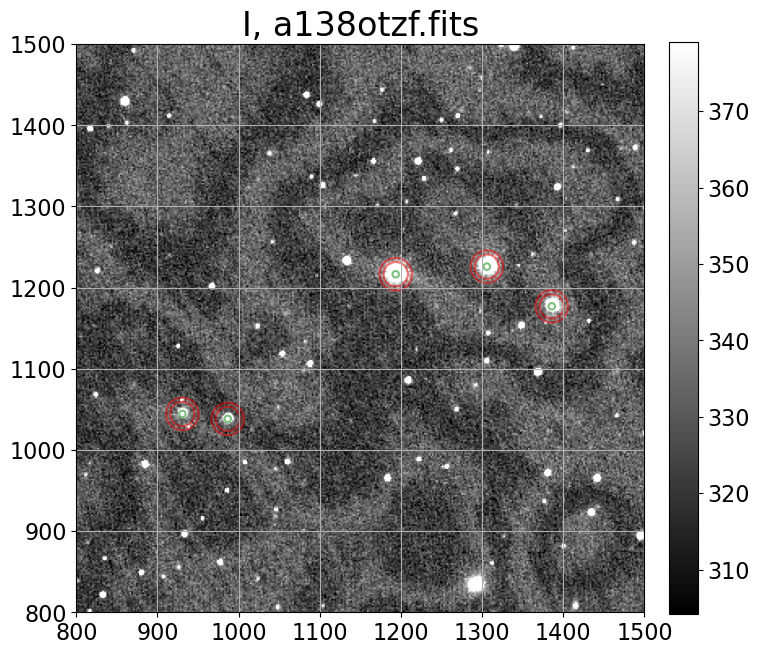

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


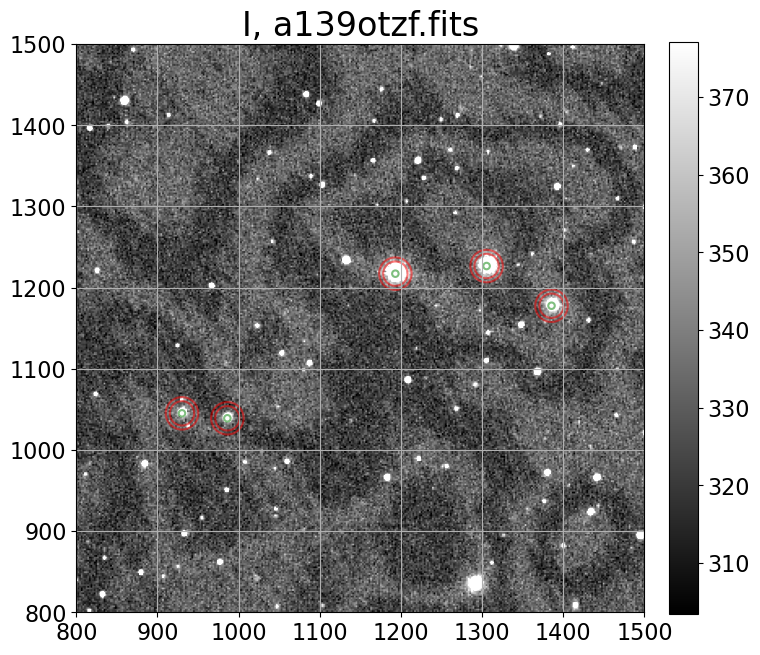

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


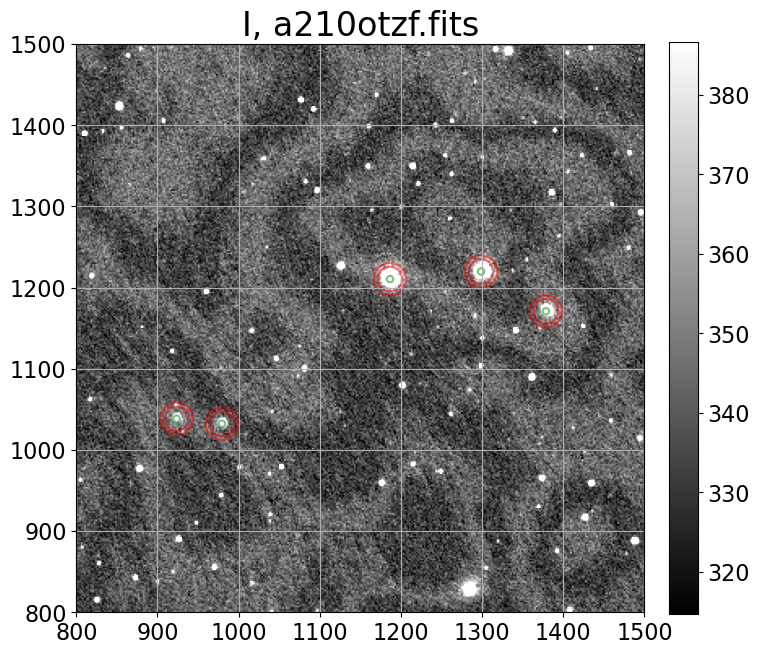

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


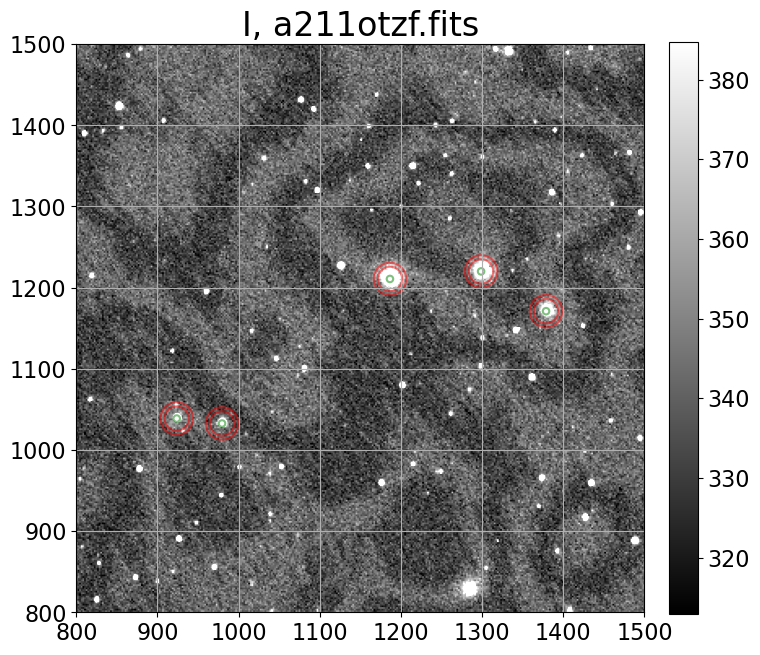

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


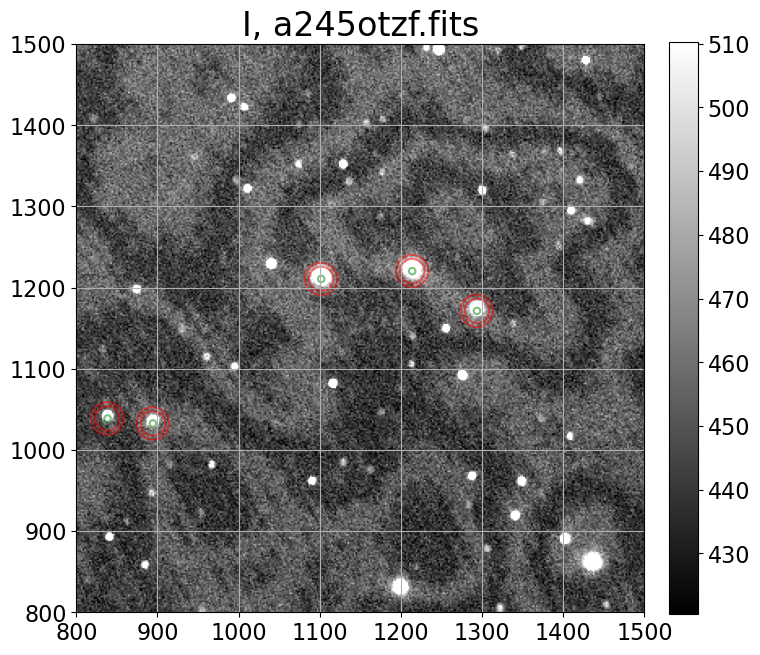

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


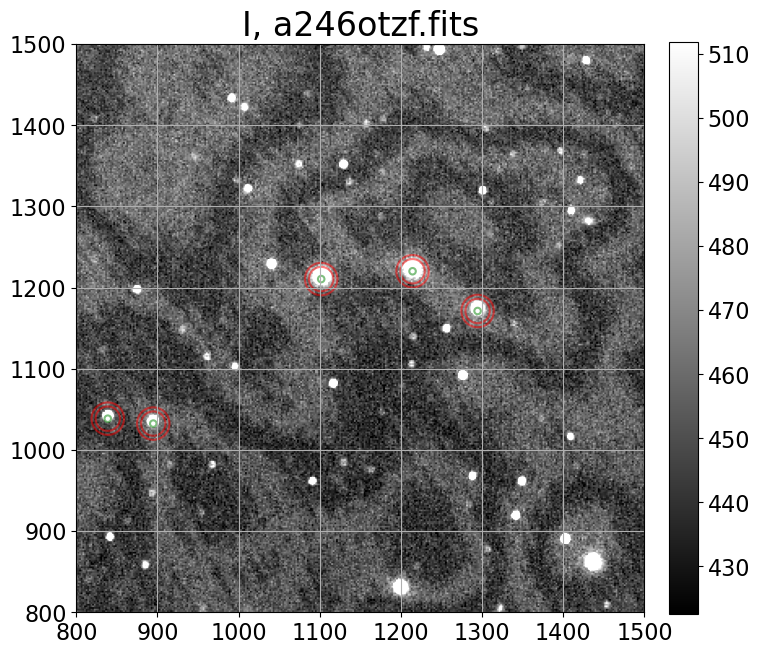

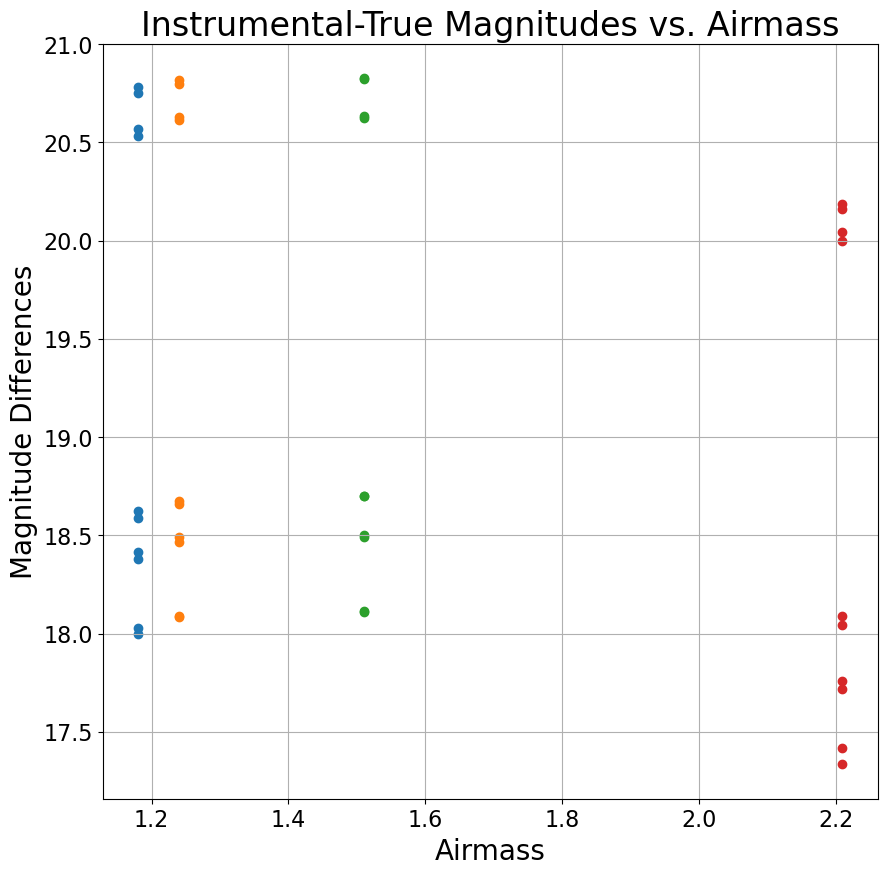

LinregressResult(slope=-0.6289580027687807, intercept=20.12236519782839, rvalue=-0.21628440745688593, pvalue=0.1800971846313946, stderr=0.4605761565489393, intercept_stderr=0.7316567916577037)


In [11]:
# grab the science frames
# skip Ha, because it's only observed at one airmass
imgs       = ccdp.ImageFileCollection(reduced_dir,glob_include='*otzf.fits')
sci_files  = imgs.files_filtered(imagetyp='science',object='pg1633',include_path=True)
sci = ((imgs.summary['imagetyp'] == 'science') & (imgs.summary['filter'] != 'Ha'))
sci_filters = set(imgs.summary['filter'][sci])

# these are found from imxam for the V filter, but work well enough to find positions in the other filters
# it is important that the positions go in order 1-A-B-C-D to match the standard mags I stored in the Landolt table
approx_pos = [[(988.8683,1049.2803),(1044.8029,1043.2159),(1251.6695,1221.4295),(1363.9839,1230.9691),(1444.0144,1182.0372)],\
[(987.9844,1049.2036),(1043.8968,1043.1361),(1250.6889,1221.1958),(1363.0112,1230.7516),(1443.0305,1181.8385)],\
[(931.8118,1043.4529),(987.6939,1037.3564),(1194.6650,1215.5002),(1307.0202,1225.0282),(1386.9956,1176.1044)],\
[(932.0204,1043.5176),(987.9188,1037.3954),(1194.7984,1215.5333),(1307.1397,1225.0323),(1387.0961,1176.0627)],\
[(924.4201,1037.0850),(980.2808,1030.9915),(1187.3280,1208.8491),(1299.5213,1218.2871),(1379.4235,1169.3869)],\
[(925.3480,1036.7100),(981.2349,1030.6284),(1188.1673,1208.4725),(1300.4663,1217.9357),(1380.4332,1168.9797)],\
[(838.3982,1039.8684),(894.1732,1033.8111),(1101.0422,1211.7489),(1213.2663,1221.1237),(1293.3098,1172.1284)],\
[(838.1403,1039.7337),(893.9993,1033.6562),(1100.9368,1211.3933),(1213.1794,1220.8576),(1293.1324,1171.9191)]]

# set up an astropy Table for standard transformations
standards = Table()
standards['filter'] = [filtr for filtr in sci_filters]
standards['k'] = np.zeros(len(sci_filters))

airmass = [1.18]*10 + [1.24]*10 + [1.51]*10 + [2.21]*10
airmasses = [1.18, 1.24, 1.51, 2.21]


# loop over the filters
for filtr,ii in zip(sci_filters,range(len(sci_filters))):
    # get files in this filter
    sci_infilter = imgs.files_filtered(imagetyp='science', object='pg1633',filter=filtr,include_path=True)
    
    if filtr=='V': # skip the linearity test
        sci_infilter = sci_infilter[7:]
    
    # do aperture photometry
    phot = [get_phot(file,approx_pos[i],filtr+', '+file.split('/')[-1]) for file,i in zip(sci_infilter,range(len(sci_infilter)))]
    i_diff_mags = [] #setting up an empty list where the magnitude differences will be stored
    for i in range(8): #Because there are 8 frames per filter, phot will produce 8 tables for each of the five filters. So, we iterate over each table. 
        for j in range(5): #For the first set of tables produced in one filter, this will be used to iterate over each row
            i_diff_mags.append(phot[i][j][5]) #this will grab the last column value, which is the magnitude difference, and append it into i_diff_mags
    
    #plotting the magnitude differences with respect to the airmasses. 
    plt.figure(1)
    plt.title("Instrumental-True Magnitudes vs. Airmass")
    plt.scatter([airmasses[0]]*10, i_diff_mags[:10])
    plt.scatter([airmasses[1]]*10, i_diff_mags[10:20])
    plt.scatter([airmasses[2]]*10, i_diff_mags[20:30])
    plt.scatter([airmasses[3]]*10, i_diff_mags[30:40])
    plt.xlabel("Airmass")
    plt.ylabel("Magnitude Differences")
    plt.show()
    
    linregress_var = linregress(np.array(airmass), np.array(i_diff_mags)) #This is how we calculate the slope and the y-intercept. The slope is the extinction coefficient. 
    print(linregress_var)
    

These are the resulting values for the extinction coefficient per filter. 

In [14]:
U_ext = -0.1167294030436613
U_intercept = 17.14063538352047

B_ext = -0.31599148215627776
B_intercept = 19.818944165001998

V_ext = -0.46476510328163206
V_intercept = 19.765299960310564

R_ext = -0.47603720189656995
R_intercept = 20.076718145951737

I_ext = -0.6289580027687807
I_intercept = 20.12236519782839

# Number 2:

After extinction correcting your standard stars to zero airmasses (i.e., you’re correcting to the top of the atmosphere), make a plot of the difference between real magnitudes and instrumental magnitudes using your standard stars as a function of V−R color and B−V color. Fit a linear relation to this trend. The fit gives you your instrumental zero points and the first order color term which let you transform your instrumental photometry to the standard system. Tabulate the instrumental zero point and first order color terms for each band in a neat, digestible way.

In this part of the assignment, we are correcting the standard stars by the following equation: 

$y = x - (k * \chi) $

where x is the magnitude, k is the extinction coefficient, and $\chi$ is the airmass.

In [16]:
k = V_ext
accepted_magnitudes = [6, 6, 6, 6, 5, 
                       6, 6, 6, 6, 5] #we double the values because there's 10 magnitudes. 

for filtr,ii in zip(sci_filters,range(len(sci_filters))):
    # get files in this filter
    sci_infilter = imgs.files_filtered(imagetyp='science', object='pg1633',filter=filtr,include_path=True)
    
    if filtr=='V': # skip the linearity test
        sci_infilter = sci_infilter[7:]
    
    # do aperture photometry
        j_diff_mags = []
        for i in range(8):
            for j in range(5):   
                j_diff_mags.append(phot[i][j][4])

j_diff_mags = np.array(j_diff_mags) 
m_1 = j_diff_mags[:10] - k * 1.18
m_2 = j_diff_mags[10:20] - k * 1.24
m_3 = j_diff_mags[20:30] - k * 1.51
m_4 = j_diff_mags[30:40] - k * 2.21

m_corrected_1 = m_1 - accepted_magnitudes
m_corrected_2 = m_2 - accepted_magnitudes
m_corrected_3 = m_3 - accepted_magnitudes
m_corrected_4 = m_4 - accepted_magnitudes

B_minus_V = [-0.192, 0.837, 1.081, 1.134, 0.535, #these are the values from the Landolt paper for B-V. 
-0.192, 0.837, 1.081, 1.134, 0.535, 
-0.192, 0.837, 1.081, 1.134, 0.535, 
-0.192, 0.837, 1.081, 1.134, 0.535, 
-0.192, 0.837, 1.081, 1.134, 0.535, 
-0.192, 0.837, 1.081, 1.134, 0.535, 
-0.192, 0.837, 1.081, 1.134, 0.535, 
-0.192, 0.837, 1.081, 1.134, 0.535]

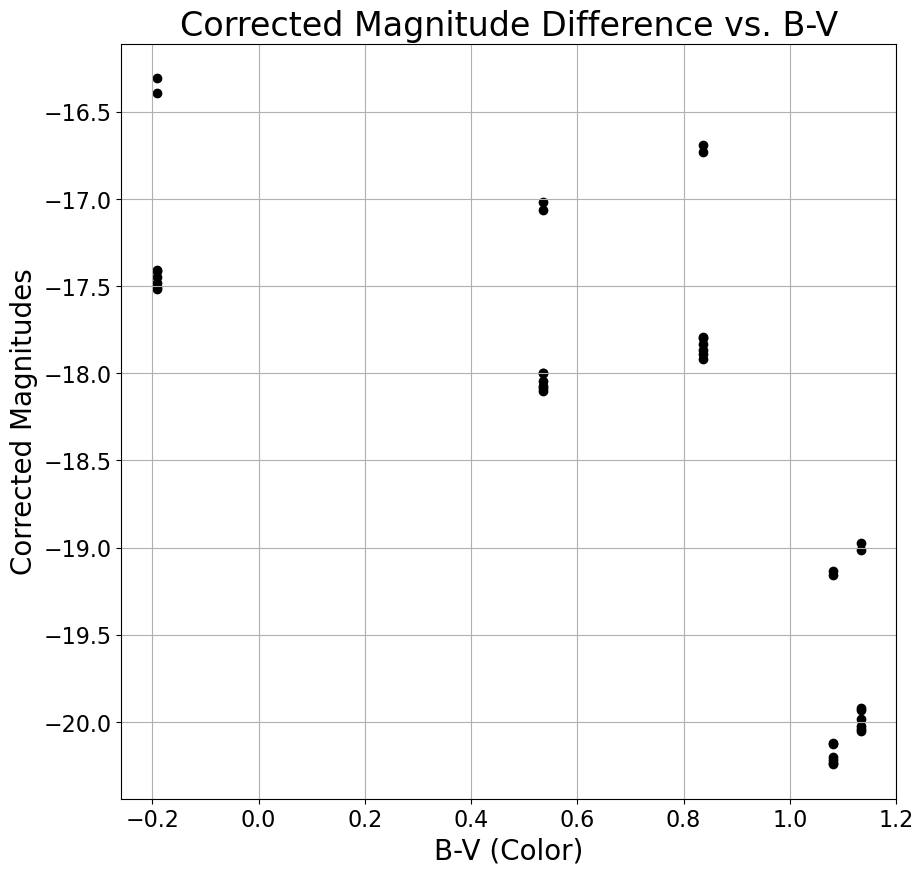

LinregressResult(slope=-1.910097750280438, intercept=-17.14654385760059, rvalue=-0.7433513737520342, pvalue=3.920534364393942e-08, stderr=0.27882491760675066, intercept_stderr=0.23255318664558572)

In [44]:
corr_mags = list(m_corrected_1) + list(m_corrected_2) + list(m_corrected_3) + list(m_corrected_4) #we put these in a list so we can plot them against the B-V values.

plt.title("Corrected Magnitude Difference vs. B-V")
plt.scatter(B_minus_V, corr_mags, c = "k")
plt.xlabel("B-V (Color)")
plt.ylabel("Corrected Magnitudes")
plt.show()
linregress(B_minus_V, corr_mags)

# Number 3:

Using the extinction terms and color terms derived for the imaging dataset previously, do photometry on the stars in NGC6823 and make a color magnitude diagram of this open cluster and compare it to a published one. Either V vs. B−V or R vs. R−I are the most common ones you might find, but there may be others. Assess in a paragraph semi-quantitatively how well does your data agree with published data? Note that your data may be affected by interstellar extinction, so you may need to deredden your data to better match the published CMD, if the published CMD has been corrected already. Use a paper such as Cardelli, Clayton, & Mathis (1989) to do the dereddening.

In [ ]:
def get_phot_new(file,approx_pos,title):
    '''
    This function takes an input file, list of positions for stars to find, and plot title.
    
    It executes the following steps:
    1. Read in the data.
    2. Find all sources in the image. It assumes the FWHM is approximately 4 pix and finds everything greater than 10 sigma.
    3. It collects the info for the sources given in the input position list, matching within 10 pixel positions.
    4. It puts r=10pix apertures on each of these stars, as well as r_in=15, r_out=20 background annuli.
    5. It calculates background-subtracted instrumental magnitudes.
    6. It plots the image and apertures for visual inspection.
    7. It returns a table of photometry.
    '''
    fwhm       = 4.0
    source_snr = 10

    sci        = CCDData.read(file,unit='adu')
    data       = sci.data
    hdr        = sci.header
    
    mean, median, std = sigma_clipped_stats(data, sigma=3.0)    
    daofind = DAOStarFinder(fwhm=fwhm, threshold=source_snr*std)    
    sources = daofind(data)
    
    positions = np.zeros_like(approx_pos)
    for position,i in zip(approx_pos,range(np.shape(approx_pos)[0])):
        match = np.where((abs(sources['xcentroid']-position[0])<10) & (abs(sources['ycentroid']-position[1])<10))[0][0]
        positions[i] = (sources['xcentroid'][match],sources['ycentroid'][match])
          
    # photometry
    # biggest FWHM is 4.2 pix
    aperture  = CircularAperture(positions, r=4)
    phot = aperture_photometry(data, aperture)
    for col in phot.colnames:
        phot[col].info.format = '%.8g'              # for consistent table output
        
    # calculate the mean background
    # note that for PG1633+099, this will include two little stars :(
    annulus_aperture = CircularAnnulus(positions, r_in=15., r_out=20.)
    bg   = aperture_photometry(data,annulus_aperture)
    for col in bg.colnames:
        bg[col].info.format = '%.8g'                # for consistent table output
    msky = bg['aperture_sum']/annulus_aperture.area # get bg cts/pixel
    
    accepted_magnitudes = [6, 6, 6, 6, 5]
    phot['inst_mag'] = -2.5 * np.log10(phot.columns['aperture_sum']-msky*aperture.area)
    #Subtract the accepted vs instrumental magnitudes here
    #phot['diff_mag'] = (phot.columns['']-phot.columns['inst_mag'])
    difference = (accepted_magnitudes-phot.columns['inst_mag'])
    for col in phot.colnames:
        phot[col].info.format = '%.8g'
    phot['diff_mag'] = difference

    # show the image with apertures
    fig, ax = plt.subplots(1, 1, figsize=(8, 8))
    show_image(data, cmap='gray', ax=ax, fig=fig)
    aperture.plot(color='green', lw=1.5, alpha=0.5) # apertures
    annulus_aperture.plot(color='red', lw=1.5, alpha=0.5)                        # bg annulus
    ax.set_xlim([800,1500])
    ax.set_ylim([800,1500])
    plt.title(title)
    plt.tight_layout()
    plt.show()
    
    return phot

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


['/Users/jonathanrodriguez/Documents/ASTR8060/Reductions1/a153otzf.fits', '/Users/jonathanrodriguez/Documents/ASTR8060/Reductions1/a154otzf.fits', '/Users/jonathanrodriguez/Documents/ASTR8060/Reductions1/a155otzf.fits', '/Users/jonathanrodriguez/Documents/ASTR8060/Reductions1/a156otzf.fits', '/Users/jonathanrodriguez/Documents/ASTR8060/Reductions1/a157otzf.fits', '/Users/jonathanrodriguez/Documents/ASTR8060/Reductions1/a158otzf.fits', '/Users/jonathanrodriguez/Documents/ASTR8060/Reductions1/a159otzf.fits', '/Users/jonathanrodriguez/Documents/ASTR8060/Reductions1/a160otzf.fits', '/Users/jonathanrodriguez/Documents/ASTR8060/Reductions1/a161otzf.fits', '/Users/jonathanrodriguez/Documents/ASTR8060/Reductions1/a162otzf.fits', '/Users/jonathanrodriguez/Documents/ASTR8060/Reductions1/a163otzf.fits']
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


IndexError: index -1 is out of bounds for axis 0 with size 0

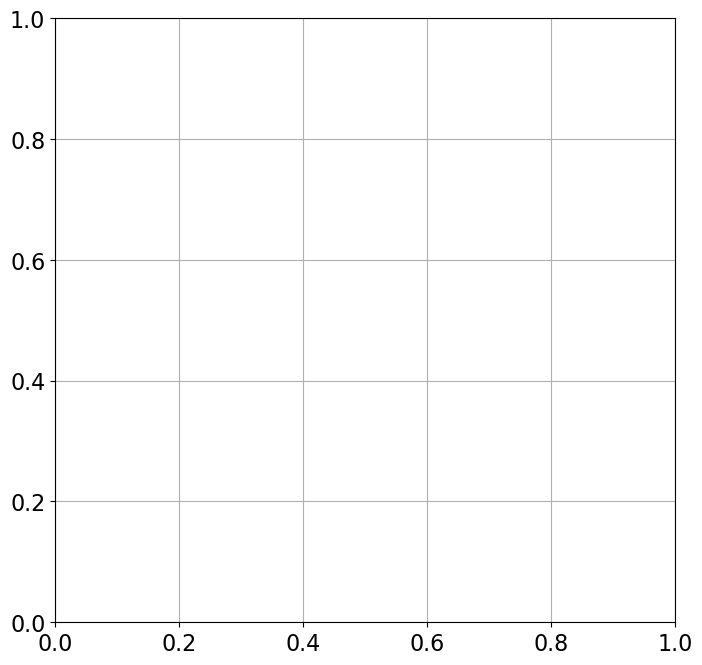

In [23]:
c1 = -1.910097750280438
c0 = -17.14654385760059

imgs       = ccdp.ImageFileCollection(reduced_dir,glob_include='*otzf.fits')
sci = ((imgs.summary['object'] == 'ngc6823') & (imgs.summary['filter'] != 'Ha'))
ngc_files = imgs.files_filtered(imagetyp='science',object='ngc6823',include_path=True)
print(ngc_files)

sci        = CCDData.read('/Users/jonathanrodriguez/Documents/ASTR8060/Reductions1/a153otzf.fits',unit='adu')
data       = sci.data

fig, ax = plt.subplots(1, 1, figsize=(8, 8))
show_image(data[739:1438,1880:1660], cmap='gray', ax=ax, fig=fig)
#aperture.plot(color='green', lw=1.5, alpha=0.5) # apertures
#annulus_aperture.plot(color='red', lw=1.5, alpha=0.5)                        # bg annulus
ax.set_xlim([739,1638])
ax.set_ylim([680,1460])
#plt.title(title)739:1438
#1880:1660
plt.tight_layout()
plt.show()

In [ ]:
approx_pos = [[(988.8683,1049.2803),(1044.8029,1043.2159),(1251.6695,1221.4295),(1363.9839,1230.9691),(1444.0144,1182.0372)],\
[(987.9844,1049.2036),(1043.8968,1043.1361),(1250.6889,1221.1958),(1363.0112,1230.7516),(1443.0305,1181.8385)],\
[(931.8118,1043.4529),(987.6939,1037.3564),(1194.6650,1215.5002),(1307.0202,1225.0282),(1386.9956,1176.1044)],\
[(932.0204,1043.5176),(987.9188,1037.3954),(1194.7984,1215.5333),(1307.1397,1225.0323),(1387.0961,1176.0627)],\
[(924.4201,1037.0850),(980.2808,1030.9915),(1187.3280,1208.8491),(1299.5213,1218.2871),(1379.4235,1169.3869)],\
[(925.3480,1036.7100),(981.2349,1030.6284),(1188.1673,1208.4725),(1300.4663,1217.9357),(1380.4332,1168.9797)],\
[(838.3982,1039.8684),(894.1732,1033.8111),(1101.0422,1211.7489),(1213.2663,1221.1237),(1293.3098,1172.1284)],\
[(838.1403,1039.7337),(893.9993,1033.6562),(1100.9368,1211.3933),(1213.1794,1220.8576),(1293.1324,1171.9191)]]

approx_pos = [[(927.08,788.84),(1014.92,748.52),(1020.68,1104.2),(1040.84,1003.4),(1086.92,955.88),(1354.76,1277),(1298.6,1223.72),(1347.56,1130.12),(1327.4,924.2),(1419.56,840.68),(1469.96,963.08),(1505.96,896.84)],\
[(987.9844,1049.2036),(1043.8968,1043.1361),(1250.6889,1221.1958),(1363.0112,1230.7516),(1443.0305,1181.8385)],\
[(838.1403,1039.7337),(893.9993,1033.6562),(1100.9368,1211.3933),(1213.1794,1220.8576),(1293.1324,1171.9191)]]

standards = Table()
standards['filter'] = [filtr for filtr in sci_filters]
standards['k'] = np.zeros(len(sci_filters))


# loop over the filters
#for filtr,ii in zip(sci_filters,range(len(sci_filters))):
    # get files in this filter
ngc_infilter = imgs.files_filtered(imagetyp='science', object='ngc6823',filter="V",include_path=True)
print(ngc_infilter+"/")
#     if filtr=='V': # skip the linearity test
#         ngc_infilter = ngc_infilter[7:]
    
    # do aperture photometry
phot = [get_phot_new(ngc_infilter+"/",approx_pos[i],"V"+', '+file.split('/')[-1]) for file,i in zip(ngc_infilter,range(len(ngc_infilter)))]
ngc_diff_mags = []
for i in range(3):
    for j in range(5):   
        ngc_diff_mags.append(phot[i][j][5])

    print(phot)
    #plt.figure(1)
    #plt.title("Instrumental-True Magnitudes vs. Airmass")
    #plt.scatter(airmass[0]*10, ngc_diff_mags[:10])
    #plt.scatter(airmass[1]*10, ngc_diff_mags[10:20])
    #plt.scatter(airmass[2]*10, ngc_diff_mags[20:30])
    #plt.scatter(airmass[3]*10, ngc_diff_mags[30:40])
    #plt.xlabel("Airmass")
    #plt.ylabel("Magnitude Differences")
    #plt.show()

# OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO

In this section, we basically use the contents of the get_phot function to store the positions of the stars (from the first image) into the sf_positions_1 variable. This variable will later be used to compare the second 

In [45]:
ngc_imgs       = ccdp.ImageFileCollection(reduced_dir,glob_include='*otzf.fits')
ngc_infilter = ngc_imgs.files_filtered(imagetyp='science', object='ngc6823',filter='V',include_path=True)

airmass = [1.18,1.24,1.51,2.21]

file = ngc_infilter[0] #we are doing this for the first image so we can eventually compare it with the other image. 
fwhm       = 5.0
source_snr = 20 #increased this number to a high value to try to weed out the fainter stars.

sci        = CCDData.read(file,unit='adu')
data       = sci.data[739:1438,880:1660] #we are specifically choosing a narrow region. 
hdr        = sci.header

mean, median, std = sigma_clipped_stats(data, sigma=3.0)    
daofind = DAOStarFinder(fwhm=fwhm, threshold=source_snr*std)    
sources = daofind(data)


print(sources)


sf_positions_1 = []
for i in range(len(sources['xcentroid'])):
    position = tuple([sources['xcentroid'][i],sources['ycentroid'][i]])
    sf_positions_1.append(position)

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
 id     xcentroid      ...        flux                mag         
--- ------------------ ... ------------------ --------------------
  1 134.49888885871786 ... 316.17792221608863   -6.249828852838691
  2  778.1483677937757 ... 1.1623601205401586 -0.16335175329706197
  3  746.4270844632241 ... 1.1233799202383088 -0.12631664212154517
  4  548.9162514166661 ... 1.2029256935487882  -0.2005970029331115
  5 378.43096657855375 ... 4.2099272850909175  -1.5606864866458863
  6  46.38738537677088 ... 42.007986239030686    -4.05832965753227
  7 473.14082699672934 ...  3.227665241898058  -1.2722212135641828
  8  561.8925193712025 ...    1.2096736036157  -0.2066705099423459
  9  219.3975159993947 ...  9.167105284455527     -2.4055805481569
 10  538.9438356994887 ... 25.813378360047587  -3.5296121178214395
...                ... ...                ...                  ...
 69  535.29

Here, we plot the first image with all of the apertures. This is important because, as we plot the next image, we will be able to see exactly what the differences are. 

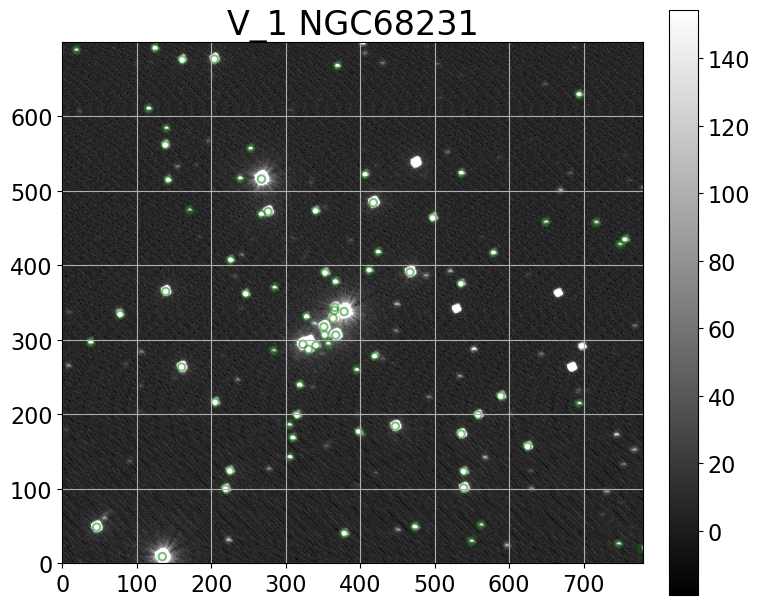

In [46]:
#make apertures
aperture  = CircularAperture(sf_positions_1, r=5)
#phot = aperture_photometry(data, aperture)
#annulus_aperture = CircularAnnulus(starfinder_pos, r_in=15., r_out=20.)


#show the image with apertures
fig, ax = plt.subplots(1, 1, figsize=(8, 8))
show_image(data, cmap='gray', ax=ax, fig=fig)
aperture.plot(color='green', lw=1.5, alpha=0.5) # apertures
#annulus_aperture.plot(color='red', lw=1.5, alpha=0.5)                        
plt.title('V_1 NGC68231')
plt.tight_layout()
plt.show()

Now that we have the starfinder positions that we found in the first image, we use them as the approximate positions for the 2nd image. We will show this second image with the apertures on the plot. 

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


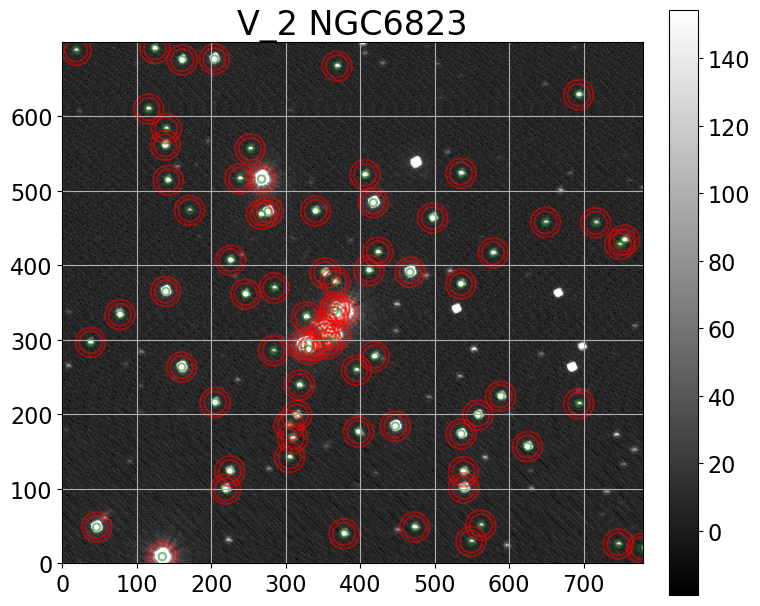

In [47]:
image2 = ngc_infilter[1] #get sources from second image
fwhm       = 5.0
source_snr = 20

sci        = CCDData.read(file,unit='adu')
data       = sci.data[739:1438,880:1660]
hdr        = sci.header

mean, median, std = sigma_clipped_stats(data, sigma=3.0)    
daofind = DAOStarFinder(fwhm=fwhm, threshold=source_snr*std)  
sources_2 = daofind(data) # starfinder sources now for the second image


sf_positions_2 = []

for i in range(len(sources_2['xcentroid'])):
    position = tuple([sources_2['xcentroid'][i],sources_2['ycentroid'][i]])
    sf_positions_2.append(position)

#make apertures
aperture  = CircularAperture(sf_positions_1, r=5)
phot_1 = aperture_photometry(data, aperture)
annulus_aperture = CircularAnnulus(sf_positions_1, r_in=15., r_out=20.)




fig, ax = plt.subplots(1, 1, figsize=(8, 8))
show_image(data, cmap='gray', ax=ax, fig=fig)
aperture.plot(color='green', lw=1.5, alpha=0.5) # apertures
annulus_aperture.plot(color='red', lw=1.5, alpha=0.5)                       
plt.title('V_2 NGC6823')
plt.tight_layout()
plt.show()
  

Now having plotted the second image, we can see that the positions of the stars in the first image do align with the stars in the second image. We can also see that the fainter stars are not included in the apertures. 

Below, we reuse the previous get_phot function, however it is modified to a new magnitude differences column based off of a magnitude value retrieved from a paper. 

In [50]:
magnitude_3 = [8]*79 #we choose this value of 8 from the "Photometric Studies of Stars in the Young Open Cluster NGC 6823 (Guetter 1992)" paper.

def get_phots_new(file,filtr):
    '''
    This function takes an input file, list of positions for stars to find, and plot title.
    
    It executes the following steps:
    1. Read in the data.
    2. Find all sources in the image. It assumes the FWHM is approximately 4 pix and finds everything greater than 10 sigma.
    3. It collects the info for the sources given in the input position list, matching within 10 pixel positions.
    4. It puts r=10pix apertures on each of these stars, as well as r_in=15, r_out=20 background annuli.
    5. It calculates background-subtracted instrumental magnitudes.
    6. It plots the image and apertures for visual inspection.
    7. It returns a table of photometry.
    '''
    fwhm       = 5.0
    source_snr = 20

    sci        = CCDData.read(file,unit='adu')
    data       = sci.data[739:1438,880:1660]
    hdr        = sci.header
    
    mean, median, std = sigma_clipped_stats(data, sigma=3.0)    
    daofind = DAOStarFinder(fwhm=fwhm, threshold=source_snr*std)    
    sources = daofind(data)
    
    #print(sources)
    
    # photometry
    # biggest FWHM is 4.2 pix
    aperture  = CircularAperture(sf_positions_1, r=5)
    phots = aperture_photometry(data, aperture)
    for col in phots.colnames:
        phots[col].info.format = '%.8g'              # for consistent table output

    annulus_aperture = CircularAnnulus(sf_positions_1, r_in=15., r_out=20.)
    bg   = aperture_photometry(data,annulus_aperture)
    
    for col in bg.colnames:
        bg[col].info.format = '%.8g'                # for consistent table output
    msky = bg['aperture_sum']/annulus_aperture.area # get bg cts/pixel
    
    
    phots['inst_mag'] = -2.5 * np.log10(phots['aperture_sum']-msky*aperture.area)
    
    phots['diff_mag'] =phots['inst_mag']-magnitude_3
    
    
    return phots

In [51]:
get_phots_new(reduced_dir+'a157otzf.fits','V') #this will perform the function on the a157otzf.fits file. 

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


/Users/jonathanrodriguez/opt/anaconda3/envs/python37/lib/python3.7/site-packages/ipykernel_launcher.py:44: RuntimeWarning: invalid value encountered in log10


id,xcenter,ycenter,aperture_sum,inst_mag,diff_mag
,pix,pix,,,
int64,float64,float64,float64,float64,float64
1,134.49889,8.9602606,1163484.7,-15.162275,-23.162275
2,778.14837,19.822687,2305.7969,-8.2441523,-16.244152
3,746.42708,25.846948,4615.9949,-9.0043691,-17.004369
4,548.91625,29.370284,4754.0056,-9.0492606,-17.049261
5,378.43097,39.68783,15200.395,-10.412459,-18.412459
6,46.387385,48.54193,156497.68,-12.977634,-20.977634
7,473.14083,48.596999,11179.312,-10.050819,-18.050819
8,561.89252,51.189523,4306.6425,-8.9127827,-16.912783


In [52]:
phot_v = [get_phots_new(reduced_dir+'a158otzf.fits','V')]
phot_b = [get_phots_new(reduced_dir+'a160otzf.fits','B')]

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


/Users/jonathanrodriguez/opt/anaconda3/envs/python37/lib/python3.7/site-packages/ipykernel_launcher.py:44: RuntimeWarning: invalid value encountered in log10
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


/Users/jonathanrodriguez/opt/anaconda3/envs/python37/lib/python3.7/site-packages/ipykernel_launcher.py:44: RuntimeWarning: invalid value encountered in log10


Here, we are looking at specific values of the phot_v variable. 

In [53]:
phot_v[0][5][:]

-24.622235
-18.310986
-18.920643
-18.997801
-20.328044
-22.895831
-20.004365
-18.840604
-21.212091
-22.202084
-20.602367


In [54]:
photb[0][5][:]

-22.489926
-16.049209
-16.506355
-16.119832
-18.025616
-20.78569
-17.373842
-16.371898
-18.360166
-20.069832
-18.233837


In [55]:
B_minus_V = (photb[0][4][:]) - (photv[0][4][:])

In [56]:
B_minus_V

0.13230904
0.26177662
0.41428848
0.8779688
0.30242791
0.11014155
0.63052332
0.46870607
0.85192473
0.13225129
0.36852921


Here, we finally plot V vs. B-V. This plot will be graphed 

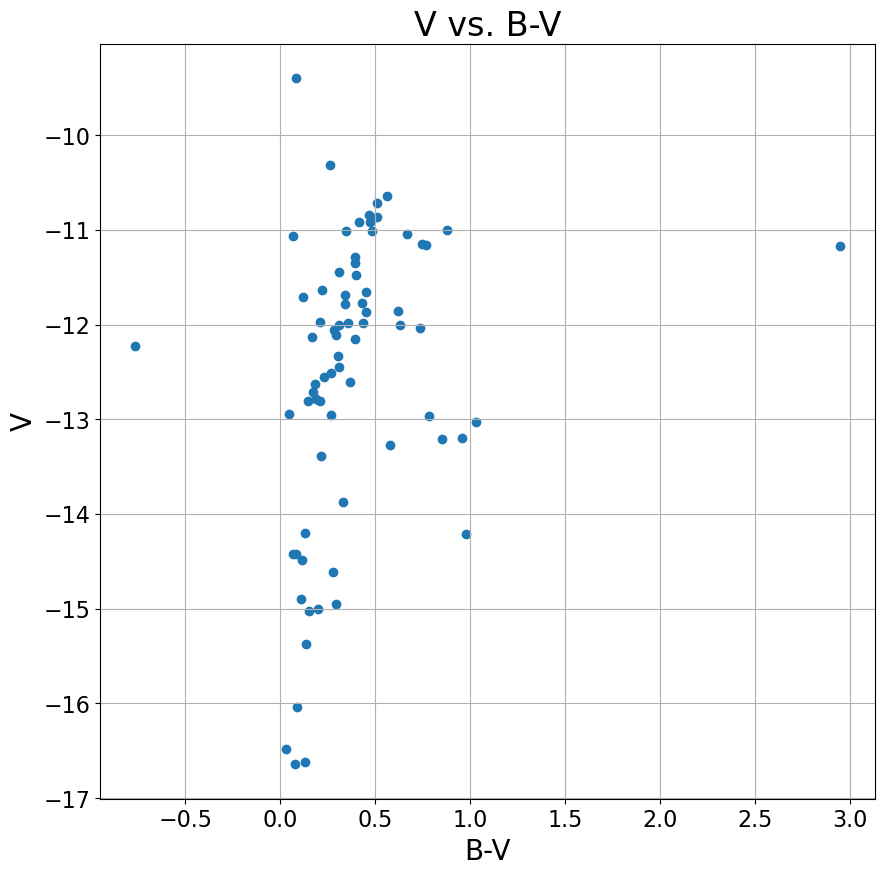

In [57]:
plt.title("V vs. B-V")
plt.scatter(B_minus_V,(photv[0][4][:]))
plt.xlabel("B-V")
plt.ylabel("V")
plt.show()

The equation shown below will be used again in order to plot the corrected magnitudes. 

$y = x - (k * \chi)$

We show what the graphs would look like with the original extinction value, what it would look like with the reddening value, and what the original graph looked like. 

In [60]:
m_v = (np.array(photv[0][4][:])) - (k*1.10)
m_b = (np.array(photb[0][4][:])) - (k*1.10)
reddening = k * 3.2
m_v_reddening = (np.array(photv[0][4][:])) - (reddening*1.10)
m_b_reddening = (np.array(photb[0][4][:])) - (reddening*1.10)


corrected = m_b - m_v
corrected_reddening = m_b_reddening - m_v_reddening

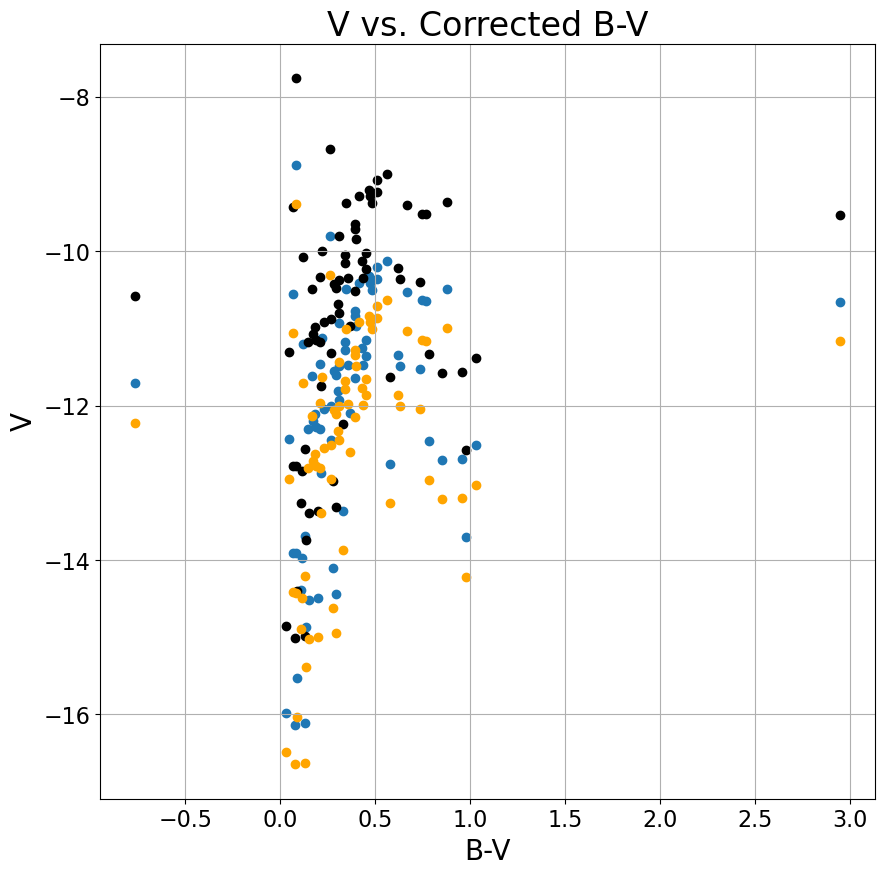

In [62]:
plt.title("V vs. Corrected B-V")
plt.scatter(corrected, m_v)
plt.scatter(corrected_reddening, m_v_reddening, c = "k")
plt.scatter(B_minus_V,(photv[0][4][:]), c = "orange")
plt.xlabel("B-V")
plt.ylabel("V")
plt.show()

We can see that the individual data points have shifted slightly from their original graph. The plot with reddening included has the largest shift. Though this graph does have a slight pattern that resembles the same graph found in  the (Guetter 1992) paper, it is not the same. Therefore, my data does not reliably agree with published data. One large difference between the published data mentioned and my data is that the published data distinguished between the types of stars in terms of their location within the open cluster. Shown below is the published data of V vs. B-V. 

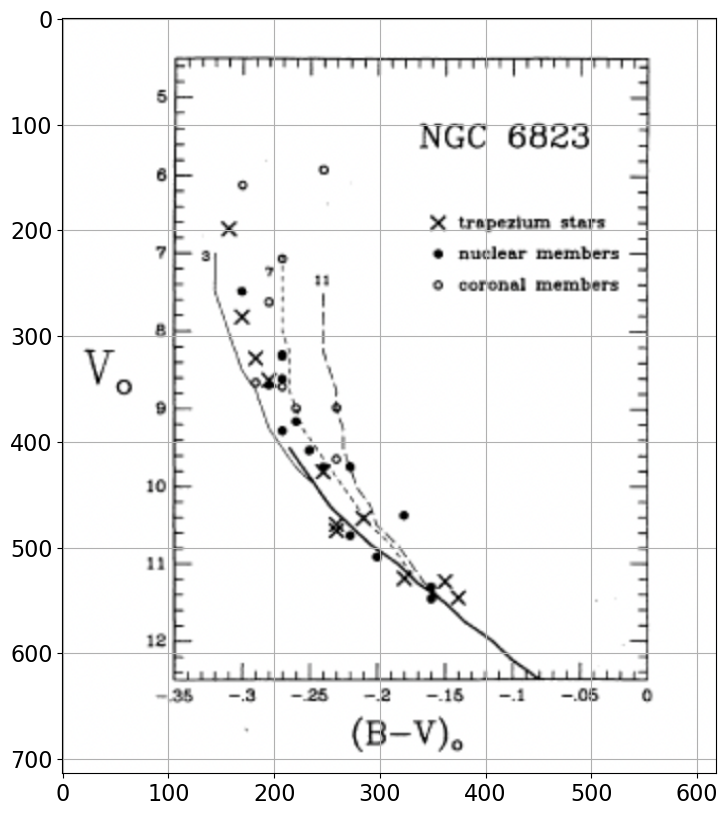

In [64]:
SN_over_radius = '/Users/jonathanrodriguez/Desktop/Guetter 1992.png'
import matplotlib.image as mpimg
plt.imshow(mpimg.imread('/Users/jonathanrodriguez/Desktop/Guetter 1992.png'))